<a href="https://colab.research.google.com/github/WANGDAKEKE/LLM4DESIGN/blob/main/0627_LLM4DESIGN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#00 初始配置 （安装一些需要的库）

In [ ]:
!pip install -U FlagEmbedding

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.4/140.4 kB 3.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 43.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.6/297.6 kB 36.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.5/171.5 kB 23.7 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_c

In [ ]:
%pip install --upgrade --quiet chromadb beautifulsoup4 langchain langchain-openai

# gpt4
! pip install openai
! pip install llama_index
! pip install langchain

# BLIP2Embedding
# ! pip install salesforce-lavis

# 依赖项
# ! pip install -U transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 525.5/525.5 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 817.7/817.7 kB 15.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.4/2.4 MB 46.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 91.9/91.9 kB 13.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.8/60.8 kB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.3/41.3 kB 6.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.4/5.4 MB 90.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.8/6.8 MB 102.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.1/60.1 kB 9.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.1/106.1 kB 15.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.3/67.3 kB 10.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (p

In [ ]:
# 依赖项
! pip install -U transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.0/9.0 MB 70.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 113.2 MB/s eta 0:00:00
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.15.2
    Uninstalling tokenizers-0.15.2:
      Successfully uninstalled tokenizers-0.15.2
  Attempting uninstall: transformers
    Found existing installation: transformers 4.38.2
    Uninstalling transformers-4.38.2:
      Successfully uninstalled transformers-4.38.2


In [ ]:
from pprint import pprint
from langchain_openai import ChatOpenAI
from openai import OpenAI
import openai
import os
import json
from langchain_community.document_loaders import WebBaseLoader
from langchain_text_splitters import RecursiveCharacterTextSplitter
from langchain_community.vectorstores import Chroma
from langchain_openai import OpenAIEmbeddings
from langchain.chains.combine_documents import create_stuff_documents_chain
from langchain.prompts import ChatPromptTemplate,MessagesPlaceholder
from langchain.memory import ChatMessageHistory
from typing import Dict
from langchain_core.runnables import RunnablePassthrough
from langchain_core.output_parsers import StrOutputParser
from langchain_core.runnables import RunnableBranch
from langchain_core.runnables.history import RunnableWithMessageHistory

连上gpt！并写好问答函数，后面就调用这个函数

In [ ]:
import random
from openai import OpenAI
import openai
import time
import random
api_key = ""  # 填入APIKEY
base_url = ""  # 使用API端点

client = OpenAI(
    api_key=api_key,
    base_url=base_url
)
import random

def generate_text(messages, model, t, f, p, retries=0): # 重试计数器retries默认为0
    try:
        seed_value = random.randint(-2147483648, 2147483647)
        if model == 3.5:
            model = "gpt-3.5-turbo"
        elif model == 4:
            model = "gpt-4-vision-preview"
        # 假设这是你调用API的代码
        response = client.chat.completions.create(
            model=model,
            messages=messages,
            temperature=t,
            frequency_penalty=f,
            presence_penalty=p,
            seed=seed_value,

        )

        return response.choices[0].message.content

    except Exception as e:
        if retries < 1000:  # 如果重试次数少于5次
            sec = random.uniform(1,3)
            print('retry: ',retries,sec,e)
            time.sleep(sec)

            return generate_text(messages, model, t, f, p, retries+1)  # 递归调用，重试计数器加1
        else:
            raise Exception(f"Failed after 5 retries. Last error: {e}")  # 超过5次重试后抛出异常


定好检索模型！

In [ ]:
from FlagEmbedding import BGEM3FlagModel
import json

# 初始化模型
model = BGEM3FlagModel('BAAI/bge-m3', use_fp16=True)
# 加载文本库
json_file_path = '/content/drive/MyDrive/result2_en_combine.json'  # 可以替换为你自己的向量检索库
# 加载你的JSON文本库
new_list = []
while len(new_list)<109001:
  with open(json_file_path, 'r', encoding='utf-8',errors='ignore') as file:
      lines = file.readlines()
      print(len(lines))
      for line in lines:
        try:
          # a+=1
          new_list.append(eval(line.strip()))
          # print(a)
        except:
          print(line)
  json_text_library = new_list
len(new_list)
import numpy as np

# Now you can use np to access NumPy functions and objects


# 读取向量库
embeddings_path = '/content/drive/MyDrive/0329json/embeddings_test.npy'
library_embeddings = np.load(embeddings_path)


/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Fetching 30 files:   0%|          | 0/30 [00:00<?, ?it/s]

README.md:   0%|          | 0.00/15.0k [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/123 [00:00<?, ?B/s]

.gitattributes:   0%|          | 0.00/1.63k [00:00<?, ?B/s]

imgs/bm25.jpg:   0%|          | 0.00/69.0k [00:00<?, ?B/s]

imgs/.DS_Store:   0%|          | 0.00/6.15k [00:00<?, ?B/s]

colbert_linear.pt:   0%|          | 0.00/2.10M [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/191 [00:00<?, ?B/s]

imgs/long.jpg:   0%|          | 0.00/485k [00:00<?, ?B/s]

imgs/mkqa.jpg:   0%|          | 0.00/608k [00:00<?, ?B/s]

imgs/others.webp:   0%|          | 0.00/21.0k [00:00<?, ?B/s]

imgs/miracl.jpg:   0%|          | 0.00/448k [00:00<?, ?B/s]

imgs/nqa.jpg:   0%|          | 0.00/158k [00:00<?, ?B/s]

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/687 [00:00<?, ?B/s]

long.jpg:   0%|          | 0.00/127k [00:00<?, ?B/s]

onnx/config.json:   0%|          | 0.00/698 [00:00<?, ?B/s]

onnx/special_tokens_map.json:   0%|          | 0.00/964 [00:00<?, ?B/s]

onnx/model.onnx_data:   0%|          | 0.00/2.27G [00:00<?, ?B/s]

onnx/Constant_7_attr__value:   0%|          | 0.00/65.6k [00:00<?, ?B/s]

onnx/sentencepiece.bpe.model:   0%|          | 0.00/5.07M [00:00<?, ?B/s]

onnx/model.onnx:   0%|          | 0.00/725k [00:00<?, ?B/s]

onnx/tokenizer_config.json:   0%|          | 0.00/1.17k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/2.27G [00:00<?, ?B/s]

onnx/tokenizer.json:   0%|          | 0.00/17.1M [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/54.0 [00:00<?, ?B/s]

sparse_linear.pt:   0%|          | 0.00/3.52k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/444 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/17.1M [00:00<?, ?B/s]

67114
67114


从另一个字典，读全文用的

In [ ]:
import json
json_alltxt_path='/content/drive/MyDrive/test0325_2_extrctalltxt+title.json'
with open(json_alltxt_path,'r',encoding='utf-8',errors='ignore')as fp:
  json_alltxt = json.load(fp)
print(type(json_alltxt))

<class 'dict'>


缓存历史记录

In [ ]:
def save_history(history, filename):
    with open('/content/drive/MyDrive/Agent/'+filename, 'w', encoding='utf-8') as file:
        json.dump(history, file, ensure_ascii=False, indent=4)
def load_history(filename):
    try:
      with open('/content/drive/MyDrive/Agent/'+filename, 'r', encoding='utf-8') as file:
          return json.load(file)
    except FileNotFoundError:
        return []

# 00 实验记录（给你这一次的运行起个名字~）



In [ ]:
timerecord='第042011次'# 记录运行次数，用于缓存历史记录

# 正式开始！ 在这里写下你的需求吧

In [ ]:
user_query= \
'''
As the client of the project, we need to design a detailed expansion plan for Keyuan Experimental School in Pingshan District, Shenzhen. \
The design should include teaching buildings with innovative educational concepts, \
multi-functional complexes, three-dimensional event platforms and underground parking facilities.\
 At the same time, the design should also include a lunch break dormitory to adapt to the daily needs of students.\
 We hope that the design will not only meet the functional needs of the school, but also promote interaction and resource sharing between the school and the surrounding community, creating a dynamic and interactive learning environment.
'''
user_query

'\nAs the client of the project, we need to design a detailed expansion plan for Keyuan Experimental School in Pingshan District, Shenzhen. The design should include teaching buildings with innovative educational concepts, multi-functional complexes, three-dimensional event platforms and underground parking facilities. At the same time, the design should also include a lunch break dormitory to adapt to the daily needs of students. We hope that the design will not only meet the functional needs of the school, but also promote interaction and resource sharing between the school and the surrounding community, creating a dynamic and interactive learning environment.\n'

# ============================创意Agent开始============================

# Agent1-提取用户关键词

In [ ]:
# 初始化历史记录
history1=[]

# 系统提示（对Agent进行角色设定）
sys_prompt1="You are an agent specialized in extracting text features. \
Your expertise lies in extracting and returning text features. \
No matter what text the user provides, you will definitely return a multitude of keywords. \
Remember, return only keywords in the format ['xx', 'xx', 'xx'], nothing else."

# 记忆加入
history1.append({"role": "system","content":[{"type": "text", "text": sys_prompt1,}],},) # 系统提示 加进 历史记录
history1.append({"role": "user","content":[{"type": "text", "text": user_query,}],},)  # 用户提示 加进 历史记录

# 开始回答
response1 = generate_text(history1,model=4,t=0.7,f=0,p=0) # ***整个历史记录丢进去，问gpt4，注意看参数***

history1.append({"role": "assistant","content":[{"type": "text", "text": response1,}],}) # AI回复 加进 历史记录

# 打印一下回答内容
print(response1)

# 保留历史记录
save_history(history1,f'01_history1_{timerecord}.json') # 缓存历史记录

['Keyuan Experimental School', 'Pingshan District', 'Shenzhen', 'expansion plan', 'teaching buildings', 'innovative educational concepts', 'multi-functional complexes', 'three-dimensional event platforms', 'underground parking facilities', 'lunch break dormitory', 'daily needs', 'students', 'functional needs', 'interaction', 'resource sharing', 'surrounding community', 'dynamic', 'interactive learning environment']


# Agent2 关键词联想

In [ ]:
history2=[]

# 系统提示（对Agent进行角色设定）
sys_prompt2="You are an imaginative artist who excels at using your imagination to conjure abstract images and emotions.\
When users give you keywords, you will surely envision some scenes and summarize them into keywords, returning 15 distinct keywords.\
 These should include abstract images unrelated to design, must not be the same as the user's input keywords,\
 and different from those discussed in previous chats. Use the format ['xx', 'xx', 'xx'], and return only keywords, nothing else."

history2.append({"role": "system","content":[{"type": "text", "text": sys_prompt2,}],},)
user= history1[-1]['content'][-1]['text'] # 这里的用户输入就是上一轮history1的最后一个回复（把Agent1的输出当成Agent2的输入，Agent2和Agent1顺接）
history2.append({"role": "user","content":[{"type": "text", "text": user,}],},)


# 在这里设计次数，也就是你想让Agent回答多少次
N=6

print('user:',user) # 打印用户提示

# Agent这个时候开始想象了
for i in range(N):
  response2 = generate_text(history2,model=4,t=1.2,f=1.2,p=1.2)  #这里的参数修改了，t+1.2的时候说话老说一半
  history2.append({"role": "user","content":[{"type": "text", "text": response2,}],}) # 把Agent2的回复当成user的输入（Agent2自我迭代）
  # 打印一下回答内容
  print(f'IMAGINATION{i}',response2)


save_history(history2,f'01_history2_{timerecord}.json')

user: ['Keyuan Experimental School', 'Pingshan District', 'Shenzhen', 'expansion plan', 'teaching buildings', 'innovative educational concepts', 'multi-functional complexes', 'three-dimensional event platforms', 'underground parking facilities', 'lunch break dormitory', 'daily needs', 'students', 'functional needs', 'interaction', 'resource sharing', 'surrounding community', 'dynamic', 'interactive learning environment']
IMAGINATION0 ['cognitive growth', 'architectural harmony', 'public engagement', 'intellectual oasis', 'collaborative spaces', 'pedagogical advancement', 'green rooftops', 'sustainable design', 'urban fabric integration',  'educational ecosystem','knowledge hub','creativity nucleus','learning landscape','community nexus','recreational arena']
IMAGINATION1 ['mental expansion', 'structural symphony', 'civic participation', 'thought sanctuary', 'cooperative realms', 'teaching evolution', 'eco terraces', 'renewable aesthetics','metropolitan weave','academic habitat','insigh

# Agent3 总结整理Agent2的工作

In [ ]:
history2_list = []
for i in range(len(history2)):
  history2_dict = {}
  content = history2[i]['content'][-1]['text']
  name = history2[i]['role']
  if name!='system':
    history2_dict[name]=content
    history2_list.append(history2_dict)

In [ ]:
history2_temp = history2

history2_temp
del history2_temp[0] # 把系统提示删了

In [ ]:
keyword_list=[]

for i in history2_temp:
  if i['role'] != 'system':
    if i['content'][0]['text'].replace('\n','').startswith('[') and i['content'][0]['text'].replace('\n','').endswith(']'):
      print(i['content'][0]['text'].replace('\n',''))
      response3=i['content'][0]['text'].replace('\n','')
      try:
        response3 = eval(response3)
      except:

        response3 =[]
        pass
      for x in response3:
        keyword_list.append(x) # 把前面所有关键词洗成 keyword_list
# print(keyowrd_list)

['Keyuan Experimental School', 'Pingshan District', 'Shenzhen', 'expansion plan', 'teaching buildings', 'innovative educational concepts', 'multi-functional complexes', 'three-dimensional event platforms', 'underground parking facilities', 'lunch break dormitory', 'daily needs', 'students', 'functional needs', 'interaction', 'resource sharing', 'surrounding community', 'dynamic', 'interactive learning environment']
['cognitive growth', 'architectural harmony', 'public engagement', 'intellectual oasis', 'collaborative spaces', 'pedagogical advancement', 'green rooftops', 'sustainable design', 'urban fabric integration',  'educational ecosystem','knowledge hub','creativity nucleus','learning landscape','community nexus','recreational arena']
['mental expansion', 'structural symphony', 'civic participation', 'thought sanctuary', 'cooperative realms', 'teaching evolution', 'eco terraces', 'renewable aesthetics','metropolitan weave','academic habitat','insight haven','imagination core','ins

#Agent4 从关键词想象画面

In [ ]:
history4=[]

sys_prompt4="You are an agent who delights in imagining scenes possessing a unique ability to craft movie scene descriptions based on keywords. Each description must be creative and detailed, ensuring that every image caption is distinct from the others. \
Regardless of the context, you are only required to provide one detailed image caption per entry. \
This caption should be a complete sentence, rich in details and vivid depictions to enhance the visual and emotional depth of the scene. \
Strive to showcase the uniqueness and artistic nature of each scene, enabling the audience to feel as though they are immersed in the movie through your words."

Max_retry = 5

history4.append({"role": "system","content":[{"type": "text", "text": sys_prompt4,}],})

for i in range(N):
  random_words = random.sample(keyword_list, 10) # 随机从keyword_list抽取10个关键词
  history4.append({"role": "user","content":[{"type": "text", "text": str(random_words),}],},) # 加入user，让Agent4生成画面
  BOOL = False
  retry = 0

  response4 = generate_text(history4,model=4,t=0.9,f=1.3,p=1.3)

  if len(response4)<=120:
    BOOL = True

  while BOOL:
    retry+=1
    response4 = generate_text(history4,model=4,t=0.9,f=1.3,p=1.3)
    print(f'!!!retry {retry} times: {response4} ')

    if len(response4)<=120:
      BOOL = True
    else:
      BOOL = False

    if retry >= Max_retry:
      break


  history4.append({"role": "assistant","content":[{"type": "text", "text": response4,}],})

  print('random keyword：',random_words)
  print(f'imagination{i}',response4)

save_history(history4,f'01_history4_{timerecord}.json')

random keyword： ['interactive learning environment', 'dynamic', 'civic participation', 'aesthetic unity', 'unity hubspot', 'ethnic mosaic', 'leisure coliseum', 'biophilic ledges', 'learning landscape', 'resilient elegance']
imagination0 In the heart of a bustling city, the Unity Hubspot comes alive as an interactive learning environment, where dynamic civic participation unfolds amidst aesthetic unity; here, people from every ethnic mosaic gather in a leisure coliseum with biophilic ledges overlooking a verdant learning landscape that epitomizes resilient elegance.
random keyword： ['Shenzhen', 'teaching buildings', 'social contribution', 'communal anchor', 'adaptive chic', 'expansion plan', 'resilient elegance', 'lunch break dormitory', 'form harmony', 'innovative educational concepts']
imagination1 In Shenzhen, within the sleek adaptive chic of its newest teaching buildings, an expansion plan rooted in social contribution unfurls; the communal anchor of this academic haven buzzes with

In [ ]:
history4_list=[]

for i in range(len(history4)):
  history4_dict = {}
  content = history4[i]['content'][-1]['text']
  name = history4[i]['role']

  if name!='system' and name != 'user':
    history4_dict[name]=content
    history4_list.append(history4_dict['assistant'])
    print({name:content})  # 画面洗成列表，给后面备用

{'assistant': 'In the heart of a bustling city, the Unity Hubspot comes alive as an interactive learning environment, where dynamic civic participation unfolds amidst aesthetic unity; here, people from every ethnic mosaic gather in a leisure coliseum with biophilic ledges overlooking a verdant learning landscape that epitomizes resilient elegance.'}
{'assistant': 'In Shenzhen, within the sleek adaptive chic of its newest teaching buildings, an expansion plan rooted in social contribution unfurls; the communal anchor of this academic haven buzzes with life as students flow from a lunch break dormitory into open-air classrooms encapsulating resilient elegance and form harmony, all designed around innovative educational concepts.'}
{'assistant': 'Amidst the lush biophilic ledges of a wisdom retreat, educators and students engage in public engagement activities that symbolize education reinvention, fostering cognitive growth through pedagogical advancement within an educational ecosystem w

# Agent5 从创意画面进行设计




In [ ]:
history5=[]

# sys_prompt5="你是个严谨的场景设计师。\
#       当给你一些描述时，你总能总结出这个画面相关的场景设计策略。\
#       无论是什么样现实还是幻想的场景，你总是能分步骤、有逻辑地用**\"先提炼场景名称，再展开设计策略\"**的方式，说出来这个场景它需要用什么策略设计。\
#       每次只需要生成一条设计策略，每次需要按照：**\'场景名称\'：\'设计策略\'**的格式返回。注意，场景名称要有创意"

sys_prompt5=" You are a serious scene designer. \
When given a description, you can always summarize the scene design strategy associated with the scene. \
No matter what kind of realistic or fantasy scene, you can always step by step and logically use the way of first refine the scene name, and then expand the design strategy to say what strategy design it needs to use for this scene. \
Only one design policy needs to be generated at a time, and each time it needs to be returned in the format: **\' Scene name \' : \' Design policy \'**. Be careful, be creative with the scene names."
history5 =  [{"role": "system","content":[{"type": "text", "text": sys_prompt5,}],},
        ]


for i in range(len(history4_list)):

  user_task = 'Generate scenario names for the following text and expand the design strategy,\ and return it in the format:**\'Scenario name\':\'Design strategy\'** (note that the scenario names should be creative):'+history4_list[i] # 迭代用户问题，一个问题一个画面

  history5.append({"role": "user","content":[{"type": "text", "text": user_task,}],},)

  response5 = generate_text(history5,model=4,t=0.9,f=0.9,p=0.9)

  if len(response5)<=120:
    BOOL = True

  while BOOL:
    retry+=1
    response5 = generate_text(history5,model=4,t=0.9,f=1.3,p=1.3)
    print(f'!!!retry {retry} times: {response5} ')

    if len(response5)<=120:
      BOOL = True
    else:
      BOOL = False

    if retry >= Max_retry:
      break

  history5.append({"role": "assistant","content":[{"type": "text", "text": response5,}],})

  print('画面：',history4_list[i].replace('\n',''))
  print(f'第{i}条策略',response5.replace('\n',''))

save_history(history5,f'01_history5_{timerecord}.json')

画面： In the heart of a bustling city, the Unity Hubspot comes alive as an interactive learning environment, where dynamic civic participation unfolds amidst aesthetic unity; here, people from every ethnic mosaic gather in a leisure coliseum with biophilic ledges overlooking a verdant learning landscape that epitomizes resilient elegance.
第0条策略 'Urban Mosaic Coliseum': 'Design strategy'Design policy: The scene design should incorporate a multi-functional urban space that encourages active civic participation and learning. The aesthetic must reflect unity, using elements that represent various ethnic backgrounds harmoniously integrated into the architecture. Incorporate biophilic design principles to create natural ledges or terraces providing views of a green landscape, reinforcing the concept of resilient elegance within an eco-friendly framework. Focus on creating interactive elements and technology-enhanced spaces to facilitate different learning experiences while promoting social int

In [ ]:
history5_list = []

for i in range(len(history5)):
  history5_dict = {}
  content = history5[i]['content'][-1]['text']
  name = history5[i]['role']
  if name!='system' and name != 'user':
    history5_dict[name]=content
    print(history5_dict['assistant'].replace('\n',''))
    history5_list.append(history5_dict['assistant']) # 再次洗成列表，完结！！

'Urban Mosaic Coliseum': 'Design strategy'Design policy: The scene design should incorporate a multi-functional urban space that encourages active civic participation and learning. The aesthetic must reflect unity, using elements that represent various ethnic backgrounds harmoniously integrated into the architecture. Incorporate biophilic design principles to create natural ledges or terraces providing views of a green landscape, reinforcing the concept of resilient elegance within an eco-friendly framework. Focus on creating interactive elements and technology-enhanced spaces to facilitate different learning experiences while promoting social interactions among diverse groups.
'Educational Elegance Enclave': 'Design strategy'Design policy: The design should focus on creating a sleek, modern teaching complex that blends aesthetic appeal with functional adaptability. Design elements should prioritize social contribution, fostering spaces that encourage communal interactions and academic

#============================创意Agent完结============================

In [ ]:
# 全部打印一遍创意Agent的工作
print('='*20,'user query'.upper(),'='*20,'\n',user_query,'\n')


print('='*20,'key words agent'.upper(),'='*20,'\n')

for i in range(len(history1)):
  content = history1[i]['content'][-1]['text']
  name = history1[i]['role']
  if name!='system' and name != 'user':
    print(i,content)
print('\n')

print('='*20,'association agent'.upper(),'='*20,'\n')
for i in range(len(history2)):
  content = history2[i]['content'][-1]['text']
  name = history2[i]['role']
  if name!='system' :
    print(i,content)
print('\n')

print('='*20,'summery tool(不重要)'.upper(),'='*20,'\n')

N = len(keyword_list)//6
for i in range(6+1):
  print(keyword_list[i*N:(i+1)*N])
print('\n')

print('='*20,'imagination agent'.upper(),'='*20,'\n')
for i in range(len(history4)):
  content = history4[i]['content'][-1]['text']
  name = history4[i]['role']
  if name!='system' and name != 'user':
    print(i,content.replace('\n',''))
print('\n')

print('='*20,'design agent'.upper(),'='*20,'\n')
for i in range(len(history5)):
  content = history5[i]['content'][-1]['text']
  name = history5[i]['role']
  if name!='system' and name != 'user':
    print(i,content.replace('\n',''))

==================== USER QUERY ==================== 
 
As the client of the project, we need to design a detailed expansion plan for Keyuan Experimental School in Pingshan District, Shenzhen. The design should include teaching buildings with innovative educational concepts, multi-functional complexes, three-dimensional event platforms and underground parking facilities. At the same time, the design should also include a lunch break dormitory to adapt to the daily needs of students. We hope that the design will not only meet the functional needs of the school, but also promote interaction and resource sharing between the school and the surrounding community, creating a dynamic and interactive learning environment.
 

==================== KEY WORDS AGENT ==================== 

2 ['Keyuan Experimental School', 'Pingshan District', 'Shenzhen', 'expansion plan', 'teaching buildings', 'innovative educational concepts', 'multi-functional complexes', 'three-dimensional event platforms', 'unde

# ============================可靠Agent开始============================

# 检索一些案例交给 Reliable Agent

In [ ]:
sys_prompt_tt="你是一个翻译专家，能将中文完整地翻译为英文"

history_tt =  [{"role": "system","content":[{"type": "text", "text": sys_prompt_tt,}],},
        {"role": "user","content":[{"type": "text", "text": '请翻译为英文'+user_query,}],},]
response_tt = generate_text(history_tt,model=3.5,t=0.7,f=0,p=0)

In [ ]:
# 定义查询文本

query_text = response_tt
# 嵌入查询文本
query_embedding = model.encode([query_text])['dense_vecs']

# 计算相似度并排序
similarity_scores = [query_embedding @ lib_emb.T for lib_emb in library_embeddings]
sorted_indices = sorted(range(len(similarity_scores)), key=lambda i: similarity_scores[i], reverse=True)



# 输出相似度最高的前几个结果的文本内容
n_results = 9  # 你想要检索的结果数量
top_results = [(similarity_scores[i], i) for i in sorted_indices[:n_results]]

logic_ref_pool = []
result_list = []

for score, idx in top_results:
    print(f"Similarity Score: {score}")
    print("Text:", json_text_library[idx]['progressed'])
    print("Image URL:", json_text_library[idx]['img'])
    print(json_text_library[idx]['id'])
    if score[0][0] == top_results[0][0][0][0]:

      id_parts = json_text_library[idx]['id'].split('-')[:-2]  # 分割并移除最后两个部分
      newid = '-'.join(id_parts)  # 重新连接剩下的部分
      print(json_alltxt[newid]['alltxt'])
      result_list.append(json_text_library[idx]['progressed']['content'])
      logic_ref_pool.append(json_alltxt[newid]['alltxt'])  # 所以这个pool是全文，不是logic

Similarity Score: [[0.691]]
Text: {'content': 'Special education schools implement a teaching model that combines "medical care" with education. The related regulations have more detailed and strict requirements for the design of the buildings, which greatly affect the design flexibility. Additionally, due to the special characteristics of the student population, these schools particularly emphasize management work, with enhanced management implying safety. However, is a homogenized campus space and fixed learning behaviors and environments what students truly need and enjoy? Students in special education often have difficulty communicating normally with others, leading to feelings of inferiority and isolation. Standardized and neglectful school spaces that ignore individual student needs are unlikely to encourage communication. Therefore, in the special education school project in Heyuan City, Guangdong Province, we are attempting to make a change by designing a campus space that chil

# Agent6 提取框架构建逻辑池


N=检索出来相似度最高的图像，最高有几张就几轮

In [ ]:
# 把logic—ref-pool用gpt洗成logic-pool


history6=[]
sys_prompt6=f"You are a logical design expert. \
The current design requirement is as follows {user_query}. You need to keep this design requirement in mind all the time, and all your answers must not deviate from the design requirement. \
The user will give you the design document as a reference. As a logically rigorous design expert, you will always be able to generate a rigorous logical framework of design strategy based on the design document in conjunction with the design requirements.\
Regardless of what the user sends you, you will only return a rigorous design strategy logical framework with a point-by-point discussion, returned as this format.\
[Consider designing from xx] \
must write 9 points, each point needs to be logically related to each other, note that you need to refer to the design requirements and not deviate from them.\
nothing else."


history6_temp =  [{"role": "system","content":[{"type": "text", "text": sys_prompt6,}],},] # 角色文档

N=len(logic_ref_pool)
history6 =  [{"role": "system","content":[{"type": "text", "text": sys_prompt6,}],},]


# history6 和 history6_temp 是两个列表， history6是用来保存所有内容的 ， history6_temp是记忆清空，记忆清空
# 在这个环节，history6还没有用上，history6_temp不能删掉，因为是用来和gpt交互的

for i in range(N):
  user_prompt6 = f"Please distill the design framework based on the following design document and discuss it in points, returned as this format ['Consider design from xx','Consider design from xx',....' Consider design from xx'], must write 9 points, each point needs to be logically related to each other:.{''.join(logic_ref_pool[i])}"

  history6_temp.append({"role": "user","content":[{"type": "text", "text": user_prompt6,}],}) #user是提问的，就是王大可
  history6.append({"role": "user","content":[{"type": "text", "text": user_prompt6,}],})

  response6 = generate_text(history6_temp,model=4,t=1,f=0,p=0)

  history6.append({"role": "assistant","content":[{"type": "text", "text": response6,}],})  #assistant是gpt，是回答的

  history6_temp =  [{"role": "system","content":[{"type": "text", "text": sys_prompt6,}],},]  #temp是用来消除记忆的，防止他变懒


  print(f'第{i}个逻辑池',response6)

save_history(history6,f'01_history6_{timerecord}.json')

第0个逻辑池 ['Consider designing from the perspective of inclusive education', 'Consider designing buildings to cater to the special needs of students', 'Consider designing multifunctional spaces for versatile use', 'Consider incorporating local architectural characteristics into the school design', 'Consider creating secure and controlled access points', 'Consider including interactive and communication-stimulating spaces', 'Consider integrating nature and landscape into the school design', 'Consider facilities for family involvement and community interaction', 'Consider designing from a sustainable and future-oriented approach']
第1个逻辑池 ['Consider designing from the perspective of spatial experience', 'Consider designing from the integration
第2个逻辑池 ['Consider the integration of historic cultural preservation in design', 'Consider incorporating collective memory into space functionality', 'Consider enhancing community interaction through design', 'Consider design adaptability for diverse ed

In [ ]:
logic_pool=[]

for i in history6:
  if i['role'] == 'assistant':
    if i['content'][0]['text'].replace('\n','').startswith('[') and i['content'][0]['text'].replace('\n','').endswith(']'):
      print(i['content'][0]['text'].replace('\n',''))
      logic=i['content'][0]['text'].replace('\n','')
      logic = eval(logic) # 整成列表
      logic_pool.append(logic)

['Consider designing from the perspective of inclusive education', 'Consider designing buildings to cater to the special needs of students', 'Consider designing multifunctional spaces for versatile use', 'Consider incorporating local architectural characteristics into the school design', 'Consider creating secure and controlled access points', 'Consider including interactive and communication-stimulating spaces', 'Consider integrating nature and landscape into the school design', 'Consider facilities for family involvement and community interaction', 'Consider designing from a sustainable and future-oriented approach']
['Consider the integration of historic cultural preservation in design', 'Consider incorporating collective memory into space functionality', 'Consider enhancing community interaction through design', 'Consider design adaptability for diverse educational purposes', 'Consider the aesthetic harmonization of architecture with local heritage', 'Consider the integration of mo

# Agent7 严谨设计师撰写方案

In [ ]:

#从逻辑池任选1条，分布细化，只干了一次
history7_initial=[]
sys_prompt7_initial = f"You're a rigorous scenario designer who helps users with very detailed design strategies based on the logic of what they want to do"
history7_initial = [{"role": "system","content":[{"type": "text", "text": sys_prompt7_initial,}],},]
user_logic = random.sample(logic_pool,1)
history7_initial.append({"role": "user","content":[{"type": "text", "text": f'help me refine the design strategy in steps based on the logic of {user_logic}, the requirements are as follows：{user_query}',}]})
# 上面这一行之前修改过

response7_initial = generate_text(history7_initial,model=4,t=0.7,f=0,p=0)
history7_initial.append({"role": "assistant","content":[{"type": "text", "text": response7_initial,}]})

save_history(history7_initial,f'01_history7_initial_{timerecord}.json')

In [ ]:
history7_initial

[{'role': 'system',
  'content': [{'type': 'text',
    'text': "You're a rigorous scenario designer who helps users with very detailed design strategies based on the logic of what they want to do"}]},
 {'role': 'user',
  'content': [{'type': 'text',
    'text': "help me refine the design strategy in steps based on the logic of [['Consider design from an innovative educational concept perspective', 'Consider design from multi-functional space usage', 'Consider design from three-dimensional event platform integration', 'Consider design from underground parking facility incorporation', 'Consider design from daily need adaptation for lunch break dormitories', 'Consider design from promoting school-community interaction and resource sharing', 'Consider design from sustainability and the use of recycled materials', 'Consider design from knowledge exchange and community involvement', 'Consider design from flexible space that can evolve over time']], the requirements are as follows：\nAs the cl

#============================可靠Agent完结============================

In [ ]:
print('='*20,'user query'.upper(),'='*20,'\n',user_query,'\n')


print('='*20,'Retrievaling...'.upper(),'='*20,'\n')

for i in result_list:
  print(i)
print('\n')

print('='*20,'logic pool agent'.upper(),'='*20,'\n')

for i in logic_pool:
  print(i)
print('\n')

print('='*20,'Random Logic！'.upper(),'='*20,'\n')
print(user_logic)
print('\n')

print('='*20,'Reliable agent'.upper(),'='*20,'\n')
print(response7_initial)
print('\n')

==================== USER QUERY ==================== 
 
As the client of the project, we need to design a detailed expansion plan for Keyuan Experimental School in Pingshan District, Shenzhen. The design should include teaching buildings with innovative educational concepts, multi-functional complexes, three-dimensional event platforms and underground parking facilities. At the same time, the design should also include a lunch break dormitory to adapt to the daily needs of students. We hope that the design will not only meet the functional needs of the school, but also promote interaction and resource sharing between the school and the surrounding community, creating a dynamic and interactive learning environment.
 

==================== RETRIEVALING... ==================== 

Special education schools implement a teaching model that combines "medical care" with education. The related regulations have more detailed and strict requirements for the design of the buildings, which greatly a

#============================Battle Time开始============================

#严谨设计师Agent7 vs 创意设计师Agent5_new

In [ ]:
history5_new=[]
history7=[]
sys_prompt5_new=f"You're a creative designer, and the chats are all about your design strategy for user needs. \
        The user will discuss with you how it wants to be designed, you will feel that he is not innovative, you will counter the user's point of view and teach the user to innovate from a design perspective based on your design experience in the chat transcripts. \
        But you must also always respect the user's needs, which are as follows [remember, you must always counter the user, not have a polite conversation]:{user_query}"
history5_new = [{"role": "system","content":[{"type": "text", "text": sys_prompt5_new,}],},]

for i in history5_list:
  history5_new.append({"role": "assistant","content":[{"type": "text", "text": str(i),}],},)

sys_prompt7 = f"You're a rigorous scenario designer, and the chats are all about what you think is correct scenario design logic. \
        The user will discuss with you how it wants to be designed, you will feel that he is not rigorous, does not follow the correct design logic, and does not respect the user's needs, you will be based on the chat transcripts of your design logic, refute the user's point of view and teach the user that you should be rigorous to do the design. \
        You compared to creativity you will feel more concerned about respecting the user's needs, the user's needs are as follows [keep in mind that you must have been rebutting the user instead of having a polite conversation]:{user_query}"
history7= [{"role": "system","content":[{"type": "text", "text": sys_prompt7,}],},]

for i in logic_pool:
  history7.append({"role": "assistant","content":[{"type": "text", "text": str(i),}],},)

history5_new.append({"role": "user","content":[{"type": "text", "text": response7_initial,}],},)
history7.append({"role": "assistant","content":[{"type": "text", "text": response7_initial,}],},)


In [ ]:
N = 6
for i in range(N):
  print(f'\n===================Round {i}=====================\n')

  response5_new = generate_text(history5_new,model=4,t=0.9,f=0.9,p=0.9)
  history7.append({"role": "user","content":[{"type": "text", "text": response5_new,}],},)
  history5_new.append({"role": "assistant","content":[{"type": "text", "text": response5_new,}],},)

  print('创意设计师')
  print('\n')
  print(response5_new)
  print('\n')

  response7 = generate_text(history7,model=4,t=0.7,f=0,p=0)
  history7.append({"role": "assistant","content":[{"type": "text", "text": response7,}],},)
  history5_new.append({"role": "user","content":[{"type": "text", "text": response7,}],},)


  print('严谨设计师')
  print('\n')
  print(response7)
  print('\n')


save_history(history5_new,f'01_history5_new_{timerecord}.json')
save_history(history7,f'01_history7_{timerecord}.json')


===================Round 0=====================

创意设计师


While I appreciate the meticulous step-by-step approach, let's ignite some real innovation here. You're sticking too closely to the standard playbook – it's time to shake things up.

**Step 1: Research and Disruption**
- Forget just incorporating innovative educational concepts. Let's redefine them. We need a paradigm shift, not just an integration.
- Multi-functional spaces? They're old news. We're aiming for transformative spaces that adapt in real-time to users' needs.

**Step 2: Design Revolution**
- Initial sketches are fine, but we'll push past initial. Our designs will be living entities that evolve with pedagogical advancements.
- Underground parking should not just be efficient; it should also incorporate clean energy solutions and robotic vehicle management systems.

**Step 3: Dormitory Redefined**
- The lunch break dormitories won't just cater to rest; they will be recuperative pods equipped with sensory relaxation te

# Agent8 严谨视角总结

In [ ]:
history8=[]
sys_prompt8 = f"You're a very critical lead designer, you're very good at summarizing, and chat transcripts are facts about your conversations with users. \
              You will have a long discussion, and at the end you will summarize the complete design strategy based on the user requirements, and based on the conversation with the user. [Please note that you need to remember the user requirements all the time, and the strategy must not deviate from the requirements] \
              The user requirements are as follows：{user_query}"


history8=history7[(-N)*2-1:]
history8.append({"role": "system","content":[{"type": "text", "text": sys_prompt8,}],})

In [ ]:
N = 9
print('\n===============框架=================\n')
history8.append({"role": "user","content":[{"type": "text", "text": f'I appreciate and agree with your approach. Could you please summarize the process we have discussed? First, generate an overall framework for the design, and then we can delve into the details point by point. For now, could you create a concise framework consisting of six subheadings that will serve as the main structure? Also, please provide a suitable title for this framework.',}]})
response8 = generate_text(history8,model=4,t=0.9,f=0.9,p=0.9)
print(response8)
history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]})

history8.append({"role": "user","content":[{"type": "text", "text": f'Following our recent discussions, I agree with your proposed approach and appreciate your insights. To proceed, please first develop an initial design framework that succinctly outlines the structure. Could you start by providing a concise framework with six subheadings as the main skeleton? Additionally, I would appreciate a relevant title for this framework. Once this is established, we can expand each point in detail.',}]})
response8 = generate_text(history8,model=4,t=0.9,f=0.9,p=0.9)
print(response8)
history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]}
                )
history8.append({"role": "user","content":[{"type": "text", "text": f'Very well, let us check again to make sure there are indeed nine subheadings. \
Please review our chat history and return these nine points to me in the following format:\
[number: subheading, number: subheading, ...,number: subheading]',}]})


response8 = generate_text(history8,model=4,t=0.9,f=0.9,p=0.9)
print(response8)
history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]})
framwork = response8
print('\n===============框架=================\n')

print('\n===============细化=================\n')
for i in range(N):
  if i == 0:
    history8.append({"role": "user","content":[{"type": "text", "text": f'answer me in english\
                                          Great, now the design framework part is over. Our framework now consists of{framwork}。\n\
                                          Now that we have the framework, let us write out the specifics heading by heading. Start by writing out the specifics of the {i+1}th subheading.\n\
                                          Please review our chat and consider detailing that the return format is [number,subheadings,specifics]\n\
                                          Attention! I am asking for the specifics of the {i+1}th subheading, not give me the entire design framework!',}]})
   else:
    history8.append({"role": "user","content":[{"type": "text", "text": f'\Great, go ahead. This is the design framework we discussed earlier:{framwork}\n\
                                          now generate the specific content for subtitle {i+1},Please review our chat and consider detailing that the return format is [number,subheadings,specifics]。\n\
                                          Attention! I am asking for the specifics of the {i+1}th subheading, not give me the entire design framework!',}]})

  response8 = generate_text(history8,model=4,t=0.7,f=0,p=0)
  print(response8)
  history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]})
print('\n===============细化=================\n')

save_history(history8,f'01_history8_{timerecord}.json')


===============框架=================

Title: "Integrated Development Blueprint for Keyuan Experimental School"

**1. Educational Infrastructure and Progressive Pedagogy**
   - Focus on modern, flexible learning environments that enable a fusion of traditional teaching methods with cutting-edge educational technologies.

**2. Architectural Versatility and Community Integration**
   - Design adaptable multi-use buildings capable of hosting school functions alongside community events, fostering unity and resource optimization.

**3. Dynamic Learning Platforms and Interactive Spaces**
   - Incorporate interactive platforms within the design to facilitate experiential learning while encouraging creativity through well-thought-out spaces.

**4. Efficient Use of Space and Sustainable Mobility**
   - Emphasize sustainable transportation options with an eco-friendly underground parking system, optimizing spatial usage throughout the campus.

**5. Restorative Student Accommodations**
   - Devise 

# Agent9创意视角总结

In [ ]:
history9=[]

sys_prompt9 = f"You're a very creative lead designer, you're very good at summarizing, and chat transcripts are facts about your conversations with users. \
              You will have a long discussion, and at the end you will summarize the complete framework first, and then discuss the specific design strategy in points, based on the user's needs, and based on the conversation with the user. [Please note that you need to keep the user needs in mind all the time, and the strategy must not deviate from the needs]\
              The user requirements are as follows:{user_query}"

history9=history5_new[(-N)*2-1:]
history9.append({"role": "system","content":[{"type": "text", "text": sys_prompt9,}],})

In [ ]:
N = 9
history8 = history9
print('\n===============框架=================\n')
history8.append({"role": "user","content":[{"type": "text", "text": f'I appreciate and agree with your approach. Could you please summarize the process we have discussed? First, generate an overall framework for the design, and then we can delve into the details point by point. For now, could you create a concise framework consisting of six subheadings that will serve as the main structure? Also, please provide a suitable title for this framework.',}]})
response8 = generate_text(history8,model=4,t=0.9,f=0.9,p=0.9)
print(response8)
history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]})

history8.append({"role": "user","content":[{"type": "text", "text": f'Following our recent discussions, I agree with your proposed approach and appreciate your insights. To proceed, please first develop an initial design framework that succinctly outlines the structure. Could you start by providing a concise framework with six subheadings as the main skeleton? Additionally, I would appreciate a relevant title for this framework. Once this is established, we can expand each point in detail.',}]})
response8 = generate_text(history8,model=4,t=0.9,f=0.9,p=0.9)
print(response8)
history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]}
                )
history8.append({"role": "user","content":[{"type": "text", "text": f'Very well, let us check again to make sure there are indeed nine subheadings. \
Please review our chat history and return these nine points to me in the following format:\
[number: subheading, number: subheading, ...,number: subheading]',}]})
print('\n===============框架=================\n')

print('\n===============细化=================\n')
for i in range(N):
  if i == 0:
    history8.append({"role": "user","content":[{"type": "text", "text": f'answer me in english\
                                          Great, now the design framework part is over. Our framework now consists of{framwork}。\n\
                                          Now that we have the framework, let us write out the specifics heading by heading. Start by writing out the specifics of the {i+1}th subheading.\n\
                                          Please review our chat and consider detailing that the return format is [number,subheadings,specifics]\n\
                                          Attention! I am asking for the specifics of the {i+1}th subheading, not give me the entire design framework!',}]})
  else:
    history8.append({"role": "user","content":[{"type": "text", "text": f'\Great, go ahead. This is the design framework we discussed earlier:{framwork}\n\
                                          now generate the specific content for subtitle {i+1},Please review our chat and consider detailing that the return format is [number,subheadings,specifics]。\n\
                                          Attention! I am asking for the specifics of the {i+1}th subheading, not give me the entire design framework!',}]})

  response8 = generate_text(history8,model=4,t=0.7,f=0,p=0)
  print(response8)
  history8.append({"role": "assistant","content":[{"type": "text", "text": response8,}]})
print('\n===============细化=================\n')


history9 = history8
save_history(history9,f'01_history9_{timerecord}.json')


===============框架=================

Title: "Synergistic Learning Landscape: A Framework for Keyuan Experimental School Expansion"

1. Innovative Educational Infrastructure
2. Multi-Functional Community Complex
3. Dynamic Event Platforms
4. Eco-Conscious Transit Solutions
5. Regenerative Break Spaces
6. Interactive and Collaborative Exteriors
Title: "Keyuan Cohesion Blueprint: A Framework for Educational Elevation and

===============框架=================


===============细化=================

I apologize for the confusion earlier. Upon reviewing our discussion, it seems we have established six subheadings for the Keyuan Experimental School expansion framework. Here they are in the requested format:

1. Innovative Educational Infrastructure: Develop state-of-the-art teaching buildings that embody advanced educational concepts, equipped with adaptable learning environments and integrated technology.
2. Multi-Functional Community Complex: Create spaces that serve multiple purposes, transiti

In [ ]:
history9

[{'role': 'assistant',
  'content': [{'type': 'text',
    'text': "'Urban Mosaic Coliseum': 'Design strategy'\n\nDesign policy: The scene design should incorporate a multi-functional urban space that encourages active civic participation and learning. The aesthetic must reflect unity, using elements that represent various ethnic backgrounds harmoniously integrated into the architecture. Incorporate biophilic design principles to create natural ledges or terraces providing views of a green landscape, reinforcing the concept of resilient elegance within an eco-friendly framework. Focus on creating interactive elements and technology-enhanced spaces to facilitate different learning experiences while promoting social interactions among diverse groups."}]},
 {'role': 'assistant',
  'content': [{'type': 'text',
    'text': "'Educational Elegance Enclave': 'Design strategy'\n\nDesign policy: The design should focus on creating a sleek, modern teaching complex that blends aesthetic appeal with

In [ ]:
for i in range(len(history9)):
  content = history9[i]['content'][-1]['text']
  print(content)

'Urban Mosaic Coliseum': 'Design strategy'

Design policy: The scene design should incorporate a multi-functional urban space that encourages active civic participation and learning. The aesthetic must reflect unity, using elements that represent various ethnic backgrounds harmoniously integrated into the architecture. Incorporate biophilic design principles to create natural ledges or terraces providing views of a green landscape, reinforcing the concept of resilient elegance within an eco-friendly framework. Focus on creating interactive elements and technology-enhanced spaces to facilitate different learning experiences while promoting social interactions among diverse groups.
'Educational Elegance Enclave': 'Design strategy'

Design policy: The design should focus on creating a sleek, modern teaching complex that blends aesthetic appeal with functional adaptability. Design elements should prioritize social contribution, fostering spaces that encourage communal interactions and acad

In [ ]:
for i in range(len(history9)):
  content = history9[i]['content'][-1]['text']
  name = history9[i]['role']
  if content.startswith('Okay I have proved your idea'):
    Bool=True
  if Bool:
    if name!='system':
      if name == 'user':
        print(f'\n**********************COT_STEP {a}*********************\n')
        print('\n**********PROMPT**********\n ',content)
      elif name == 'assistant':
        print('\n**********Agent_I**********\n ',content)
        a+=1
print('\n')

#============================Battle Time 完结============================


In [ ]:
print('='*20,'user query'.upper(),'='*20,'\n',user_query,'\n')


print('='*20,'Agent_R vs Agent_I'.upper(),'='*20,'\n')
a = 0
for i in range(len(history7)):
  content = history7[i]['content'][-1]['text']
  name = history7[i]['role']


  if name!='system' and not content.startswith('[') :
    if name == 'user':
      print(f'\n**********************ROUND{a}*********************\n')
      print('\n**********Creative Agent**********\n ',content)
    elif name == 'assistant':
      print('\n**********Reliable Agent**********\n ',content)
      a+=1

print('\n')

print('='*20,'Summery by agent_I'.upper(),'='*20,'\n')
Bool = False
a=0
for i in range(len(history8)):
  content = history8[i]['content'][-1]['text']
  name = history8[i]['role']
  if content.startswith('Okay I have proved your idea'):
    Bool=True
  if Bool:
    if name!='system':
      if name == 'user':
        print(f'\n**********************COT_STEP {a}*********************\n')
        print('\n**********PROMPT**********\n ',content)
      elif name == 'assistant':
        print('\n**********Agent_R**********\n ',content)
        a+=1
print('\n')
a=0
print('='*20,'Summery by agent_R'.upper(),'='*20,'\n')
Bool=False
for i in range(len(history9)):
  content = history9[i]['content'][-1]['text']
  name = history9[i]['role']
  if content.startswith('Okay I have proved your idea'):
    Bool=True
  if Bool:
    if name!='system':
      if name == 'user':
        print(f'\n**********************COT_STEP {a}*********************\n')
        print('\n**********PROMPT**********\n ',content)
      elif name == 'assistant':
        print('\n**********Agent_I**********\n ',content)
        a+=1
print('\n')

==================== USER QUERY ==================== 
 
As the client of the project, we need to design a detailed expansion plan for Keyuan Experimental School in Pingshan District, Shenzhen. The design should include teaching buildings with innovative educational concepts, multi-functional complexes, three-dimensional event platforms and underground parking facilities. At the same time, the design should also include a lunch break dormitory to adapt to the daily needs of students. We hope that the design will not only meet the functional needs of the school, but also promote interaction and resource sharing between the school and the surrounding community, creating a dynamic and interactive learning environment.
 

==================== AGENT_R VS AGENT_I ==================== 


**********Reliable Agent**********
  To refine the design strategy for the expansion plan of Keyuan Experimental School, we will follow a step-by-step approach that incorporates the provided logical considerat

In [ ]:
history8=load_history('01_history8_第042011次.json')

In [ ]:
for i in history8[-N*2:]:
  if i['role'] == 'assistant':
    # if i['content'][0]['text'].startswith('[') and i['content'][0]['text'].endswith(']'):
      print(i['content'][0]['text'])

['1', 'Holistic Educational Design', 'This element of the design strategy focuses on the fusion of advanced educational methodologies with architectural innovation to create a learning environment that is both stimulating and supportive. The aim is to align the physical spaces with the school's educational philosophy, incorporating flexibility, technology, and collaboration areas that cater to a variety of learning styles and teaching methods.']
['2', 'Functionally Dynamic Architecture', 'The design will include adaptable architectural structures capable of facilitating a diverse range of activities. These buildings will be designed to accommodate the needs of both educational and community events, ensuring a seamless transition in functionality. The goal is to create spaces that are not only versatile but also capable of supporting the dynamic nature of educational and community engagement.']
['3', 'Collaborative and Interactive Platforms', 'These spaces within the school will be dedi

In [ ]:
for i in history9[-N*2:]:
  if i['role'] == 'assistant':
    # if i['content'][0]['text'].startswith('[') and i['content'][0]['text'].endswith(']'):
      print(i['content'][0]['text'])

I apologize for the confusion earlier. Upon reviewing our discussion, it seems we have established six subheadings for the Keyuan Experimental School expansion framework. Here they are in the requested format:

1. Innovative Educational Infrastructure: Develop state-of-the-art teaching buildings that embody advanced educational concepts, equipped with adaptable learning environments and integrated technology.
2. Multi-Functional Community Complex: Create spaces that serve multiple purposes, transitioning seamlessly between educational functions and community engagement.
3. Dynamic Event Platforms: Incorporate versatile event venues that can host a range of school and community activities, fostering an atmosphere of interaction and collaboration.
4. Eco-Conscious Transit Solutions: Design an underground parking facility that prioritizes sustainability and supports a variety of transportation options.
5. Regenerative Break Spaces: Establish lunch break dormitories that cater to the well-

In [ ]:
print('='*20,'user query'.upper(),'='*20,'\n',user_query,'\n')


print('='*20,'Agent_R vs Agent_I'.upper(),'='*20,'\n')
a = 0
for i in range(len(history7)):
  content = history7[i]['content'][-1]['text']
  name = history7[i]['role']


  if name!='system' and not content.startswith('[') :
    if name == 'user':
      print(f'\n**********************ROUND{a}*********************\n')
      print('\n**********Creative Agent**********\n ',content)
    elif name == 'assistant':
      print('\n**********Reliable Agent**********\n ',content)
      a+=1

print('\n')

print('='*20,'Summery by agent_I'.upper(),'='*20,'\n')
Bool = False
a=0
for i in range(len(history8)):
  content = history8[i]['content'][-1]['text']
  name = history8[i]['role']
  if content.startswith('好的，我已经认可你的想法'):
    Bool=True
  if Bool:
    if name!='system':
      if name == 'user':
        print(f'\n**********************COT_STEP {a}*********************\n')
        print('\n**********PROMPT**********\n ',content)
      elif name == 'assistant':
        print('\n**********Agent_R**********\n ',content)
        a+=1
print('\n')
a=0
print('='*20,'Summery by agent_R'.upper(),'='*20,'\n')
Bool=False
for i in range(len(history9)):
  content = history9[i]['content'][-1]['text']
  name = history9[i]['role']
  if content.startswith('好的，我已经认可你的想法'):
    Bool=True
  if Bool:
    if name!='system':
      if name == 'user':
        print(f'\n**********************COT_STEP {a}*********************\n')
        print('\n**********PROMPT**********\n ',content)
      elif name == 'assistant':
        print('\n**********Agent_I**********\n ',content)
        a+=1
print('\n')

==================== USER QUERY ==================== 
 
As the client of the project, we need to design a detailed expansion plan for Keyuan Experimental School in Pingshan District, Shenzhen. The design should include teaching buildings with innovative educational concepts, multi-functional complexes, three-dimensional event platforms and underground parking facilities. At the same time, the design should also include a lunch break dormitory to adapt to the daily needs of students. We hope that the design will not only meet the functional needs of the school, but also promote interaction and resource sharing between the school and the surrounding community, creating a dynamic and interactive learning environment.
 

==================== AGENT_R VS AGENT_I ==================== 


**********Reliable Agent**********
  To refine the design strategy for the expansion plan of Keyuan Experimental School, we will follow a step-by-step approach that incorporates the provided logical considerat

#============================视觉Agent开始============================

# Vitrul Agent进行出图前的总结

In [ ]:
history8 = load_history('01_history8_第二次.json')

In [ ]:
policy_list=[]
for i in history8[-9*2:]:
  if i['role'] == 'assistant':
    if i['content'][0]['text'].startswith('[') and i['content'][0]['text'].endswith(']'):
      print(i['content'][0]['text'])
      policy_list.append(i['content'][0]['text'])

['1', 'Holistic Educational Design', 'This element of the design strategy focuses on the fusion of advanced educational methodologies with architectural innovation to create a learning environment that is both stimulating and supportive. The aim is to align the physical spaces with the school's educational philosophy, incorporating flexibility, technology, and collaboration areas that cater to a variety of learning styles and teaching methods.']
['2', 'Functionally Dynamic Architecture', 'The design will include adaptable architectural structures capable of facilitating a diverse range of activities. These buildings will be designed to accommodate the needs of both educational and community events, ensuring a seamless transition in functionality. The goal is to create spaces that are not only versatile but also capable of supporting the dynamic nature of educational and community engagement.']
['3', 'Collaborative and Interactive Platforms', 'These spaces within the school will be dedi

In [ ]:
sys_prompt10 = f"You're a design expert, you're very good at design, and after giving you a design strategy you can give a post-design scene image caption accordingly.\
         No matter what design strategy you are given, you will always be able to generate a post-design scene image caption, and the only thing you return is the post-design scene image caption, within 77 tokens, in English, nothing else. \
         Please note that your post-design scene must not deviate from the user requirements, which are as follows：{user_query}"

history10=[]
history10.append({"role": "system","content":[{"type": "text", "text": sys_prompt10,}],})

for i in range(len(policy_list)):
  history10.append({"role": "user","content":[{"type": "text", "text": f'The design strategy is as follows: {i}, please return the image caption, as detailed as possible to describe each detail of the image, 77 tokens or less, in English, just return a paragraph of the image caption, nothing else',}],})
  response10 = generate_text(history10,model=4,t=0.7,f=0,p=0)
  print(response10)
  history10.append({"role": "assistant","content":[{"type": "text", "text": response10,}]})

"Keyuan Experimental School's expansion showcases modern teaching buildings, a vibrant multi-functional complex, tiered event spaces, subterranean parking, and cozy dormitories, fostering community engagement and interactive learning."
"Innovative Keyuan School expansion: interactive classrooms, versatile complex, layered activity areas, underground parking, and restful student dorms, blending education with community vitality."
"Keyuan School's new phase: cutting-edge educational spaces, multifunctional
"Revolutionized Keyuan School with advanced learning environments, versatile hub, elevated
"Keyuan Experimental School's evolution: smart classrooms, dynamic multi-use complex, interactive terraces, concealed parking, and tranquil dormitories, harmonizing education with community."
"Keyuan School's redesign: state-of-the-art educational facilities, multipurpose complex, engaging event platforms, integrated parking, and serene nap dorms, fostering communal educational synergy."


In [ ]:
prompt_list=[]
a = 0
for i in range(len(history10)):
  content = history10[i]['content'][-1]['text']
  name = history10[i]['role']

  if name!='system' and name != 'user':

      prompt_list.append(content)
      print(content)

"Keyuan Experimental School's expansion showcases modern teaching buildings, a vibrant multi-functional complex, tiered event spaces, subterranean parking, and cozy dormitories, fostering community engagement and interactive learning."
"Innovative Keyuan School expansion: interactive classrooms, versatile complex, layered activity areas, underground parking, and restful student dorms, blending education with community vitality."
"Keyuan School's new phase: cutting-edge educational spaces, multifunctional
"Revolutionized Keyuan School with advanced learning environments, versatile hub, elevated
"Keyuan Experimental School's evolution: smart classrooms, dynamic multi-use complex, interactive terraces, concealed parking, and tranquil dormitories, harmonizing education with community."
"Keyuan School's redesign: state-of-the-art educational facilities, multipurpose complex, engaging event platforms, integrated parking, and serene nap dorms, fostering communal educational synergy."


In [ ]:
policy_list2=[]


for i in history9[-N*2:]:
  if i['role'] == 'assistant':
    # if i['content'][0]['text'].startswith('[') and i['content'][0]['text'].endswith(']'):
      print(i['content'][0]['text'])
      policy_list2.append(i['content'][0]['text'])

I apologize for the confusion earlier. Upon reviewing our discussion, it seems we have established six subheadings for the Keyuan Experimental School expansion framework. Here they are in the requested format:

1. Innovative Educational Infrastructure: Develop state-of-the-art teaching buildings that embody advanced educational concepts, equipped with adaptable learning environments and integrated technology.
2. Multi-Functional Community Complex: Create spaces that serve multiple purposes, transitioning seamlessly between educational functions and community engagement.
3. Dynamic Event Platforms: Incorporate versatile event venues that can host a range of school and community activities, fostering an atmosphere of interaction and collaboration.
4. Eco-Conscious Transit Solutions: Design an underground parking facility that prioritizes sustainability and supports a variety of transportation options.
5. Regenerative Break Spaces: Establish lunch break dormitories that cater to the well-

In [ ]:
policy_list2

['I apologize for the confusion earlier. Upon reviewing our discussion, it seems we have established six subheadings for the Keyuan Experimental School expansion framework. Here they are in the requested format:\n\n1. Innovative Educational Infrastructure: Develop state-of-the-art teaching buildings that embody advanced educational concepts, equipped with adaptable learning environments and integrated technology.\n2. Multi-Functional Community Complex: Create spaces that serve multiple purposes, transitioning seamlessly between educational functions and community engagement.\n3. Dynamic Event Platforms: Incorporate versatile event venues that can host a range of school and community activities, fostering an atmosphere of interaction and collaboration.\n4. Eco-Conscious Transit Solutions: Design an underground parking facility that prioritizes sustainability and supports a variety of transportation options.\n5. Regenerative Break Spaces: Establish lunch break dormitories that cater to t

In [ ]:
sys_prompt10 = f"You're a design expert, you're very good at design, and after giving you a design strategy you can give a post-design scene image caption accordingly.\
         No matter what design strategy you are given, you will always be able to generate a post-design scene image caption, and the only thing you return is the post-design scene image caption, within 77 tokens, in English, nothing else. \
         Please note that your post-design scene must not deviate from the user requirements, which are as follows：{user_query}\
         You need to give as much design detail as possible"

history10=[]
history10.append({"role": "system","content":[{"type": "text", "text": sys_prompt10,}],})

for i in range(len(policy_list2)):
  history10.append({"role": "user","content":[{"type": "text", "text": f'The design strategy is as follows: {i}, please return the image caption, as detailed as possible to describe each detail of the image, 77 tokens or less, in English, just return a paragraph of the image caption, nothing else',}],})
  response10 = generate_text(history10,model=4,t=0.7,f=0,p=0)
  print(response10)
  history10.append({"role": "assistant","content":[{"type": "text", "text": response10,}]})

"Innovative Keyuan Experimental School expansion featuring state-of-the-art educational buildings,
"Keyuan Experimental School's new multi-layered educational complex with interactive spaces, rooftop gardens, and integrated community-accessible facilities beneath a vibrant canopy."
"Keyuan Experimental School's harmonious blend of nature and education, featuring interconnected classrooms, versatile event platforms, and a serene dormitory nestled within lush greenery."
"Keyuan School's futuristic expansion: a hub of innovation with tiered educational spaces, communal atriums, and subterranean parking, encircled by interactive landscapes."
"Keyuan School's visionary expansion: eco-friendly dorms, collaborative learning buildings
"Keyuan Experimental School's new phase: creative learning spaces, multifunctional complexes with green terraces, and integrated community-friendly underground parking."
"Keyuan Experimental School's innovative expansion showcases a dynamic educational ecosystem 

In [ ]:
prompt_list2=[]
a = 0
for i in range(len(history10)):
  content = history10[i]['content'][-1]['text']
  name = history10[i]['role']

  if name!='system' and name != 'user':

      prompt_list2.append(content)
      print(content)

"Innovative Keyuan Experimental School expansion featuring state-of-the-art educational buildings,
"Keyuan Experimental School's new multi-layered educational complex with interactive spaces, rooftop gardens, and integrated community-accessible facilities beneath a vibrant canopy."
"Keyuan Experimental School's harmonious blend of nature and education, featuring interconnected classrooms, versatile event platforms, and a serene dormitory nestled within lush greenery."
"Keyuan School's futuristic expansion: a hub of innovation with tiered educational spaces, communal atriums, and subterranean parking, encircled by interactive landscapes."
"Keyuan School's visionary expansion: eco-friendly dorms, collaborative learning buildings
"Keyuan Experimental School's new phase: creative learning spaces, multifunctional complexes with green terraces, and integrated community-friendly underground parking."
"Keyuan Experimental School's innovative expansion showcases a dynamic educational ecosystem 

# Virtual利用tool出图

In [ ]:
!pip install -q diffusers transformers accelerate
!pip install -q controlnet-aux

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 33.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.6/274.6 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.6/44.6 kB 6.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 510.0/510.0 kB 49.5 MB/s eta 0:00:00


In [ ]:
from IPython.display import display

In [ ]:
import torch
import os
from huggingface_hub import HfApi
from pathlib import Path
from diffusers.utils import load_image
from PIL import Image
import numpy as np
from controlnet_aux import LineartDetector
import transformers
from diffusers import AutoencoderKL, StableDiffusionPipeline, UNet2DConditionModel

from diffusers import (
    ControlNetModel,
    StableDiffusionControlNetPipeline,
    UniPCMultistepScheduler,
    DPMSolverMultistepScheduler,
)


if torch.cuda.is_available():
    device_name = torch.device("cuda")
    torch_dtype = torch.float16
else:
    device_name = torch.device("cpu")
    torch_dtype = torch.float32

checkpoint = "ControlNet-1-1-preview/control_v11p_sd15_lineart"
scheduler = "dpmsolver"


processor = LineartDetector.from_pretrained("lllyasviel/Annotators")

negative_prompt = ("Vehicles, means of transportation, 2 heads, deformed hands, twisted fingers, double image, "
                   "long neck, malformed hands, multiple heads, extra limb, poorly drawn hands, missing limb, "
                   "disfigured, cut-off, grain, low-res, deformed, blurry, bad anatomy, disfigured, "
                   "poorly drawn face, mutation, mutated, floating limbs, disconnected limbs, long body, "
                   "poorly drawn, mutilated, mangled, surreal, extra fingers, duplicate artifacts, morbid, "
                   "gross proportions, missing arms, mutated hands, mutilated hands, cloned face, malformed, "
                   "ugly, tiling, poorly drawn hands, poorly drawn feet, poorly drawn face, out of frame, "
                   "extra limbs, disfigured, deformed, body out of frame, bad anatomy, watermark, cut off, "
                   "low contrast, underexposed, overexposed, bad art, beginner, amateur, distorted face, blurry, "
                   "draft, grainy,middle ages")


/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


sk_model.pth:   0%|          | 0.00/17.2M [00:00<?, ?B/s]

sk_model2.pth:   0%|          | 0.00/17.2M [00:00<?, ?B/s]

In [ ]:
text_encoder = transformers.CLIPTextModel.from_pretrained(
    "/content/drive/MyDrive/Agent/LandscapeSuperMix",
    subfolder = "text_encoder",
    num_hidden_layers = 11,
    torch_dtype = torch_dtype
)
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-mse").to(torch.float16)
controlnet = ControlNetModel.from_pretrained(checkpoint, torch_dtype=torch.float16)

pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "/content/drive/MyDrive/Agent/LandscapeSuperMix",
    controlnet=controlnet,
    vae=vae,
    torch_dtype=torch_dtype,
    text_encoder=text_encoder,
    safety_checker=None,
)


Some weights of the model checkpoint at /content/drive/MyDrive/Agent/LandscapeSuperMix were not used when initializing CLIPTextModel: ['text_model.encoder.layers.11.layer_norm1.bias', 'text_model.encoder.layers.11.layer_norm1.weight', 'text_model.encoder.layers.11.layer_norm2.bias', 'text_model.encoder.layers.11.layer_norm2.weight', 'text_model.encoder.layers.11.mlp.fc1.bias', 'text_model.encoder.layers.11.mlp.fc1.weight', 'text_model.encoder.layers.11.mlp.fc2.bias', 'text_model.encoder.layers.11.mlp.fc2.weight', 'text_model.encoder.layers.11.self_attn.k_proj.bias', 'text_model.encoder.layers.11.self_attn.k_proj.weight', 'text_model.encoder.layers.11.self_attn.out_proj.bias', 'text_model.encoder.layers.11.self_attn.out_proj.weight', 'text_model.encoder.layers.11.self_attn.q_proj.bias', 'text_model.encoder.layers.11.self_attn.q_proj.weight', 'text_model.encoder.layers.11.self_attn.v_proj.bias', 'text_model.encoder.layers.11.self_attn.v_proj.weight']
- This IS expected if you are initial

config.json:   0%|          | 0.00/547 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/998 [00:00<?, ?B/s]

diffusion_pytorch_model.safetensors:   0%|          | 0.00/1.45G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

/usr/local/lib/python3.10/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [ ]:
if scheduler == "dpmsolver":
    pipe.scheduler = DPMSolverMultistepScheduler.from_config(
        pipe.scheduler.config,
        use_karras_sigmas=True,
        algorithm_type='sde-dpmsolver++'
    )
else:
    pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

pipe.enable_model_cpu_offload()


This element of the design strategy focuses on the fusion of advanced educational methodologies with architectural innovation to create a learning environment that is both stimulating and supportive. The aim is to align the physical spaces with the school's educational philosophy, incorporating flexibility, technology, and collaboration areas that cater to a variety of learning styles and teaching methods. realistic,morden,buildings,sufficient details, best quality, masterpiece, high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century，lake


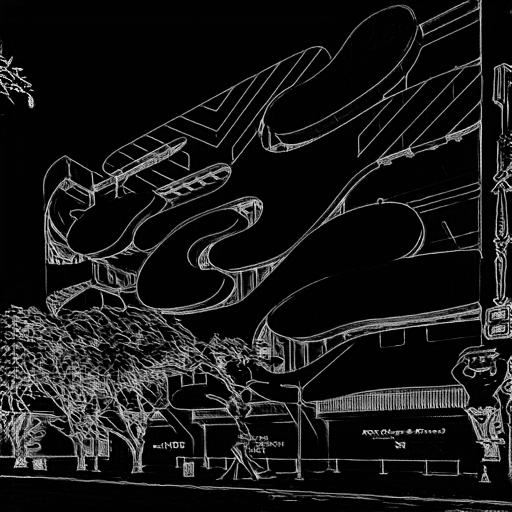

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['best quality, masterpiece, high - resolution, 8 k, high - definition, ultra realistic, highly detailed, green space, 2 1 st century ， lake']


  0%|          | 0/40 [00:00<?, ?it/s]

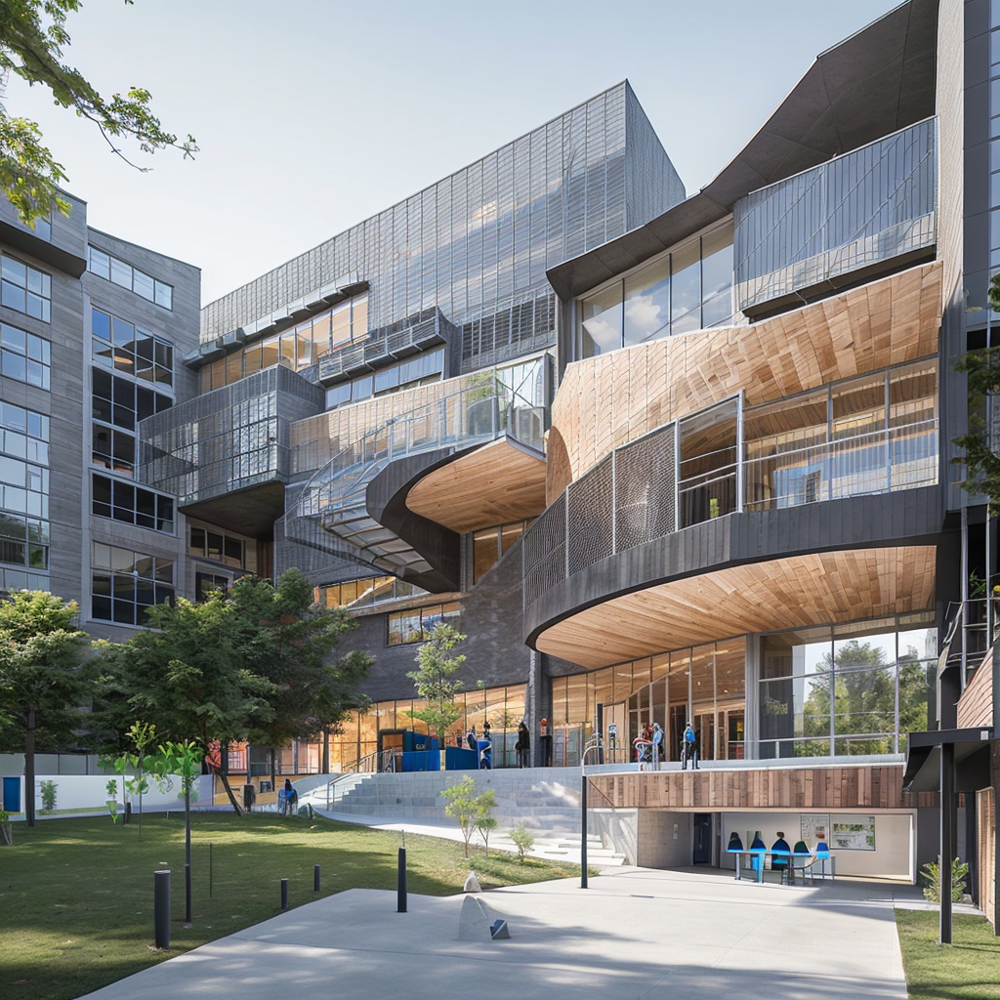

In [ ]:
prompt = ("This element of the design strategy focuses on the fusion of advanced educational methodologies with architectural innovation to create a learning environment that is both stimulating and supportive. The aim is to align the physical spaces with the school's educational philosophy, incorporating flexibility, technology, and collaboration areas that cater to a variety of learning styles and teaching methods."
          " realistic,morden,buildings,sufficient details, best quality, masterpiece, "
          "high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century，lake")
control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/1.jpg").resize((512, 512))

control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.3,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

'Functionally Dynamic Architecture', 'adaptable architectural structures capable of facilitating a diverse range of activitiesThese buildings will be designed to accommodate the needs of both educational and community events, ensuring a seamless transition in functionality. The goal is to create spaces that are not only versatile but also capable of supporting the dynamic nature of educational and community engagement. realistic,morden,buildings,sufficient details, best quality, masterpiece, high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century，lake


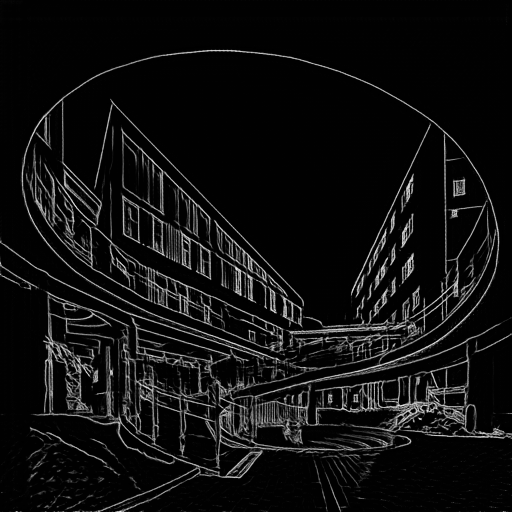

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['sufficient details, best quality, masterpiece, high - resolution, 8 k, high - definition, ultra realistic, highly detailed, green space, 2 1 st century ， lake']


  0%|          | 0/40 [00:00<?, ?it/s]

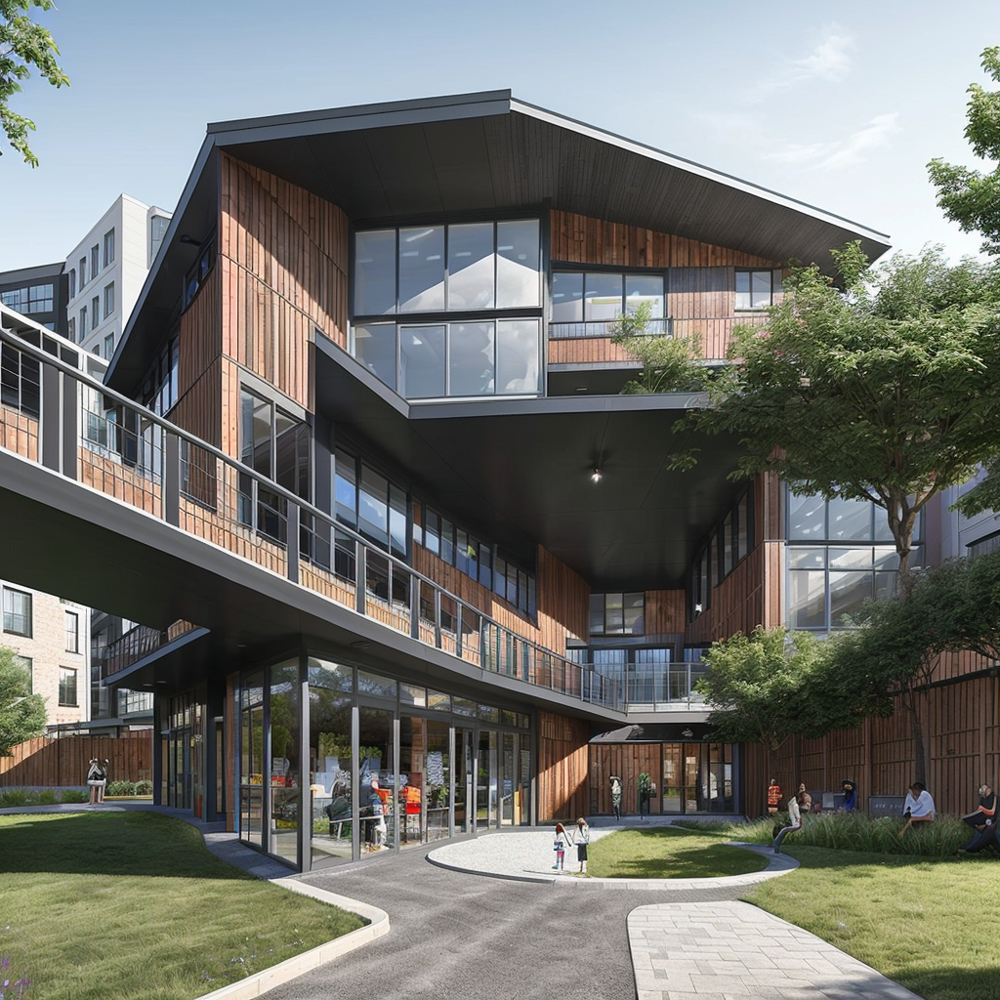

In [ ]:
prompt = ("'Functionally Dynamic Architecture', 'adaptable architectural structures capable of facilitating a diverse range of activities""These buildings will be designed to accommodate the needs of both educational and community events, ensuring a seamless transition in functionality."" The goal is to create spaces that are not only versatile but also capable of supporting the dynamic nature of educational and community engagement."" realistic,morden,buildings,sufficient details, best quality, masterpiece, "
          "high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century，lake")
control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/2.jpg").resize((512, 512))

control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.3,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

brwon architecture with glassesCollaborative and Interactive Platforms', 'fostering interaction and collaboration. ’‘outdoor spaces’‘students doing  group work, discussions, and creative projects’‘Additionally, these platforms will be equipped to host cultural events and showcase technological advancements, encouraging active participation from both students and the community, thereby enriching the educational experience.’high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century，lake


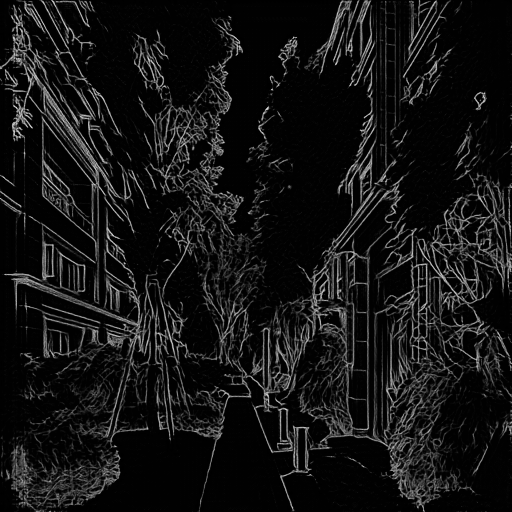

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['the educational experience.’ high - resolution, 8 k, high - definition, ultra realistic, highly detailed, green space, 2 1 st century ， lake']


  0%|          | 0/40 [00:00<?, ?it/s]

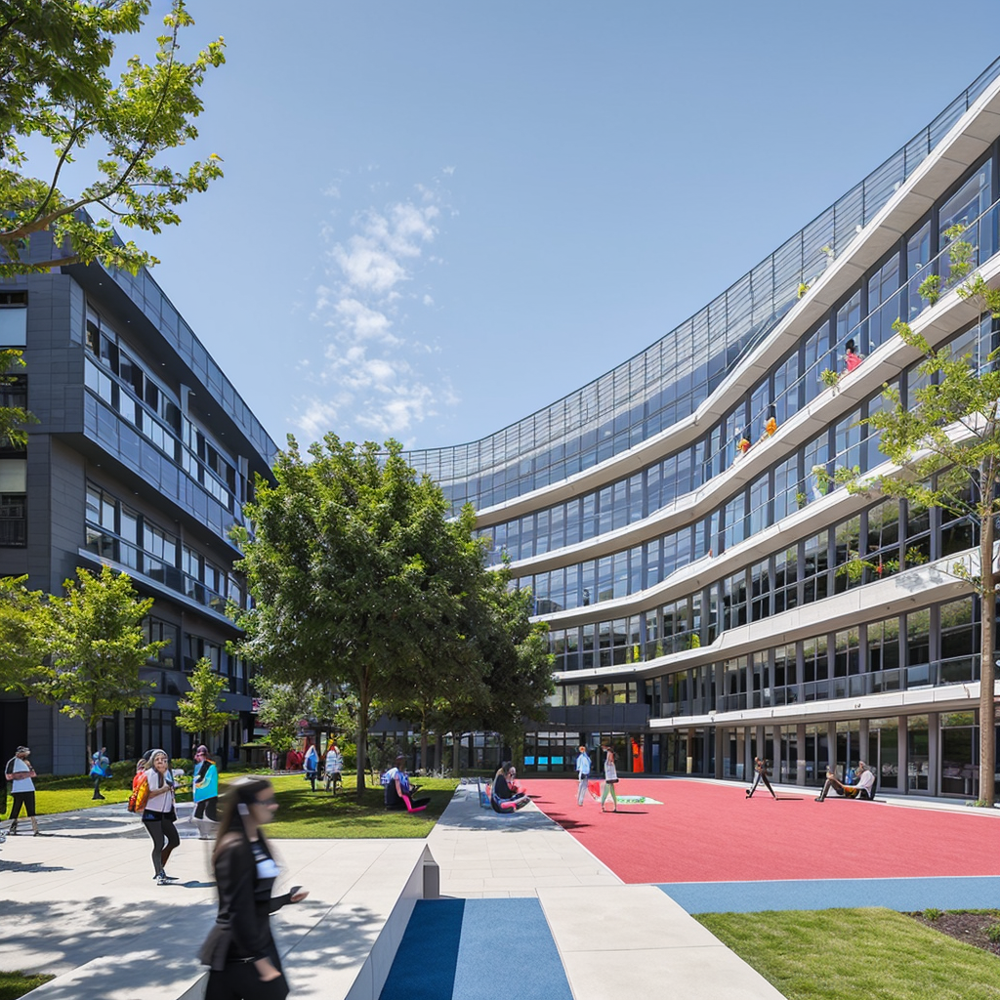

In [ ]:
prompt = ( "brwon architecture with glasses""Collaborative and Interactive Platforms', 'fostering interaction and collaboration. ’‘outdoor spaces’‘students doing  group work, discussions, and creative projects’‘Additionally, these platforms will be equipped to host cultural events and showcase technological advancements, encouraging active participation from both students and the community, thereby enriching the educational experience.’"    "high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century，lake")
control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/4.jpg").resize((512, 512))

control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.2,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

In [ ]:
generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.5,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

  0%|          | 0/40 [00:00<?, ?it/s]

Optimized Infrastructure, Accessibility, Efficient, Smart Underground Parking, Maximize Space, Reduce Surface-Level Congestion, Campus Design, Pathways, Ramps, Elevations, ADA Standards Compliance, Ease of Movement, Disability-Friendly.


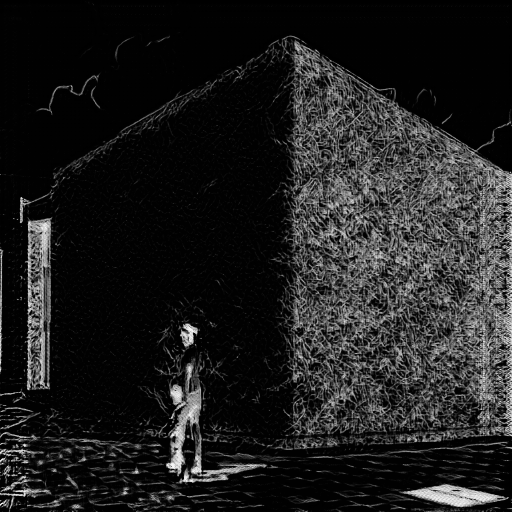

  0%|          | 0/40 [00:00<?, ?it/s]

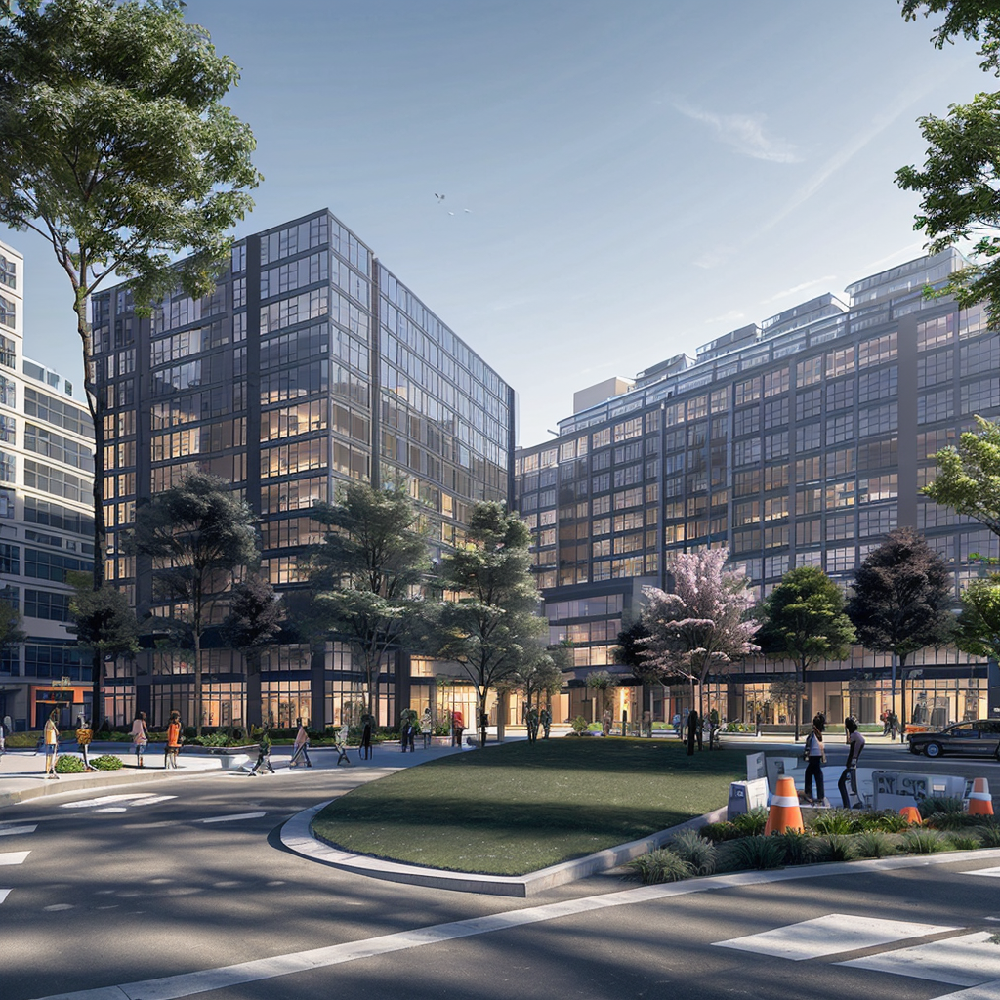

In [ ]:
prompt = ( "Optimized Infrastructure, Accessibility, Efficient, Smart Underground Parking, Maximize Space, Reduce Surface-Level Congestion, Campus Design, Pathways, Ramps, Elevations, ADA Standards Compliance, Ease of Movement, Disability-Friendly.")

control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/7.jpg").resize((512, 512))
control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.2,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

In [ ]:
# 定义查询文本

query_text = 'Student Welfare, Centric Amenities, Optimize Health,Academic Performance, Dormitories, Facilities, Rest, Relaxation, Quiet Study Zones.'

# 嵌入查询文本
query_embedding = model.encode([query_text])['dense_vecs']

# 计算相似度并排序
similarity_scores = [query_embedding @ lib_emb.T for lib_emb in library_embeddings]
sorted_indices = sorted(range(len(similarity_scores)), key=lambda i: similarity_scores[i], reverse=True)



# 输出相似度最高的前几个结果的文本内容
n_results = 9  # 你想要检索的结果数量
top_results = [(similarity_scores[i], i) for i in sorted_indices[:n_results]]

# logic_ref_pool = []
# result_list = []

for score, idx in top_results:
    print(f"Similarity Score: {score}")
    print("Text:", json_text_library[idx]['progressed'])
    print("Image URL:", json_text_library[idx]['img'])
    print(json_text_library[idx]['id'])
    if score[0][0] == top_results[0][0][0][0]:

      id_parts = json_text_library[idx]['id'].split('-')[:-2]  # 分割并移除最后两个部分
      newid = '-'.join(id_parts)  # 重新连接剩下的部分
      print(json_alltxt[newid]['alltxt'])
      # result_list.append(json_text_library[idx]['progressed']['content'])
      # logic_ref_pool.append(json_alltxt[newid]['alltxt'])  # 所以这个pool是全文，不是logic

Similarity Score: [[0.6196]]
Text: {'content': '"The project was implemented within the scope of an existing residential home. This cozy cabin was created through the combination of two opposites, serving as a secluded space for meditation and relaxation, away from the hectic pace of life, or as a place for warm encounters and positive interactions with close friends."'}
Image URL: http://labang-img.oss-cn-shenzhen.aliyuncs.com/uploads/20230216/d6451e62209cb83196e9777b20fc7f42.jpg
mei_halloo_021550-0-1
['该项目是在已存在的家庭住宅的范围内实施的。这座舒适的小木屋是由于两种对立的结合而创建的，它是一个单独冥想和放松的地方，远离疯狂的生活节奏，或者是与亲密朋友的热情会面和积极交流的地方。', '从外面看，这座朴素的建筑有巨大的彩色玻璃窗，将花园的广阔而多样的全景融入室内。毗邻的领土早在其建设构想之前就创造了这一景观。我们的任务是将它和谐地融入现有环境。', '这座吊脚楼高出地面。小木屋的位置增加了一种轻盈感，并增强了观察者从房屋中看到花园的视野。立面的装饰完全由天然材料制成：不锈钢、木材和赤陶板。一个强大的兵马俑站在这里成为背景。', '由于颜色、材料和纹理的的不同表现方式，建筑外在的苦行主义和严谨在建筑内部消失了。就像丝绸之路的多样性一样，一切都经过精心挑选和组合的。', '为了与自然充分融合，全景窗朝向日出，这样早晨就能提醒避世的业主或同伴新一天的到来。在入口的两侧，全景被一对兵马俑封闭，这对兵马俑旨在陪伴主人进入放松的世界。', '横梁之间天花板上的竹子形成了度量的图案。全景窗位于一个由抽屉组成的连续露台上，可以让你坐在花园里，同时欣赏室内外的风景。', '复古的

Student Welfare, Centric Amenities, Optimize Health, Well-Being, Academic Performance, Dormitories, Facilities, Rest, Relaxation, Quiet Study Zones, Recreational Areas, Ergonomic Design, Comfort, Green Spaces, Mental Rejuvenation, Physical Rejuvenation.


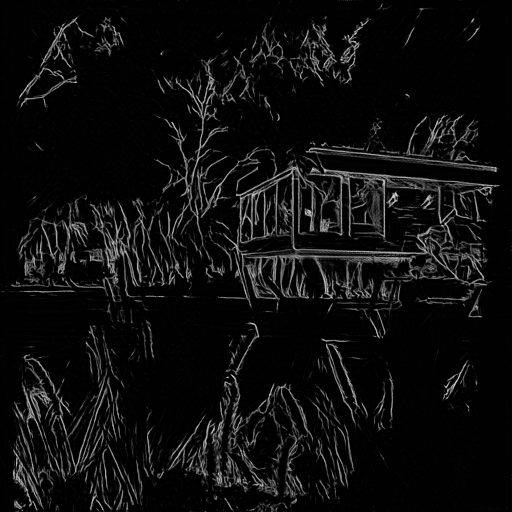

  0%|          | 0/40 [00:00<?, ?it/s]

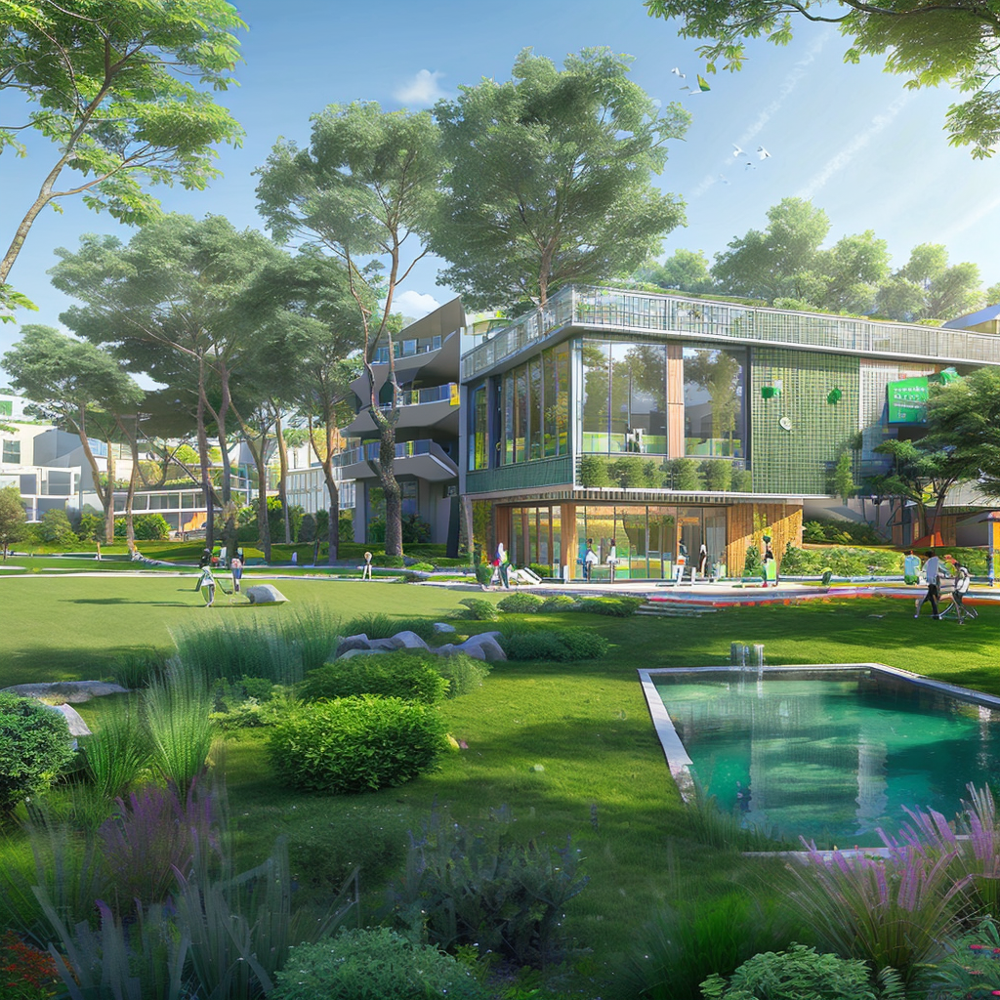

In [ ]:
prompt = ( "Student Welfare, Centric Amenities, Optimize Health, Well-Being, Academic Performance, Dormitories, Facilities, Rest, Relaxation, Quiet Study Zones, Recreational Areas, Ergonomic Design, Comfort, Green Spaces, Mental Rejuvenation, Physical Rejuvenation.")
control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/8.jpg").resize((512, 512))

control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.6,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

In [ ]:
# 定义查询文本

query_text = 'accessibility facilities , road on a slope'
# 嵌入查询文本
query_embedding = model.encode([query_text])['dense_vecs']

# 计算相似度并排序
similarity_scores = [query_embedding @ lib_emb.T for lib_emb in library_embeddings]
sorted_indices = sorted(range(len(similarity_scores)), key=lambda i: similarity_scores[i], reverse=True)



# 输出相似度最高的前几个结果的文本内容
n_results = 9  # 你想要检索的结果数量
top_results = [(similarity_scores[i], i) for i in sorted_indices[:n_results]]

# logic_ref_pool = []
# result_list = []

for score, idx in top_results:
    print(f"Similarity Score: {score}")
    print("Text:", json_text_library[idx]['progressed'])
    print("Image URL:", json_text_library[idx]['img'])
    print(json_text_library[idx]['id'])
    if score[0][0] == top_results[0][0][0][0]:

      id_parts = json_text_library[idx]['id'].split('-')[:-2]  # 分割并移除最后两个部分
      newid = '-'.join(id_parts)  # 重新连接剩下的部分
      print(json_alltxt[newid]['alltxt'])
      # result_list.append(json_text_library[idx]['progressed']['content'])
      # logic_ref_pool.append(json_alltxt[newid]['alltxt'])  # 所以这个pool是全文，不是logic

Similarity Score: [[0.6655]]
Text: {'content': '"North side corridor, north side corridor"'}
Image URL: http://labang-img.oss-cn-shenzhen.aliyuncs.com/ruzAjXqn.jpg
mei_halloo_023131-17-1
['场地', '计家墩村位于富饶的昆山，是个八十年代盖起来的村子，四周都是稻田，有两三条水道穿村而过，小桥流水，行走其间虽然不见雕梁画栋，却也是一幅江南水乡的秀丽风景。村子两年前有惊无险地逃脱了被整体拆除建工厂的厄运。妥协后的结果是被开发改造，营造一个城市人梦想中的“乡村”：安静、田园、放松、有趣。未来的村民是从上海开车一小时来这里体验乡村生活的城市人。他们在这里小住并参加各种活动，体验城市和乡村经验上的差异是他们来此的主要目的。', '计家墩村鸟瞰', '改造前后对比', '计家墩水乡风貌', '任务书', '设计任务是位于村口的村委大楼的改造和加建，让它成为未来“村民”的公共活动空间。', '业主最初并没有严格的功能要求，未来这里的空间会出租给小商户来经营酒吧、咖啡馆、商铺和工坊。唯一确定的是要有作为餐馆的大空间，以及配套厨房。需要给每个经营场所提供可以开展活动的室外空间，让有限的空间可以承载更多的活动。我们同业主一起确定了从空间操作入手的工作方式，营造从大到小有级差关系的一系列空间，并创造尽可能多的积极的公共空间。这种使用功能的不确定性一直延续到了建筑落成之后，原来计划用作餐厅的大空间被作为展览和活动空间。而每个小房间也都承载了远非可以预期的功能。', '旧建筑', '建于上世纪九十年代的村委大楼，双坡层顶、两层钢筋混凝土框架结构。东侧有一间之后加建的公厕。屋脊离地十米高，是整个村子最高大的建筑。改造前的村委大楼和大部分政府建筑一样，布局紧凑、外观平实。虽然屋顶用了青瓦坡屋顶，但四四方方的外形与城里人头脑中的江南水乡有着很大出入。特别是建筑四周都是八米高的墙面，直上直下地区分了建筑的内外，行走一周并没有一处让人想呆下来的积极空间，作为唯一的公共建筑在空间处理上却没有公共性。村委大楼的空间权力关系简单明了，大楼威严而高大，人站在跟前有压迫感，显得无足轻重。', '改造前的村委大楼平面图', '灵

Engaging Community Interface, Shared Spaces, Interaction, School, Local Community, Facilities, Libraries, Auditoriums, Sports Complexes, Dual-Use, Academic Hours, Off-Hours, Symbiotic Environment, Educational Resources, Strengthen Community Ties, Collective Growth, Learning.high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century


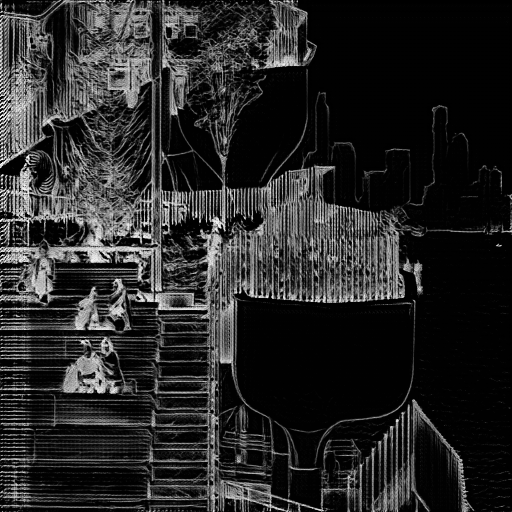

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['century']


  0%|          | 0/40 [00:00<?, ?it/s]

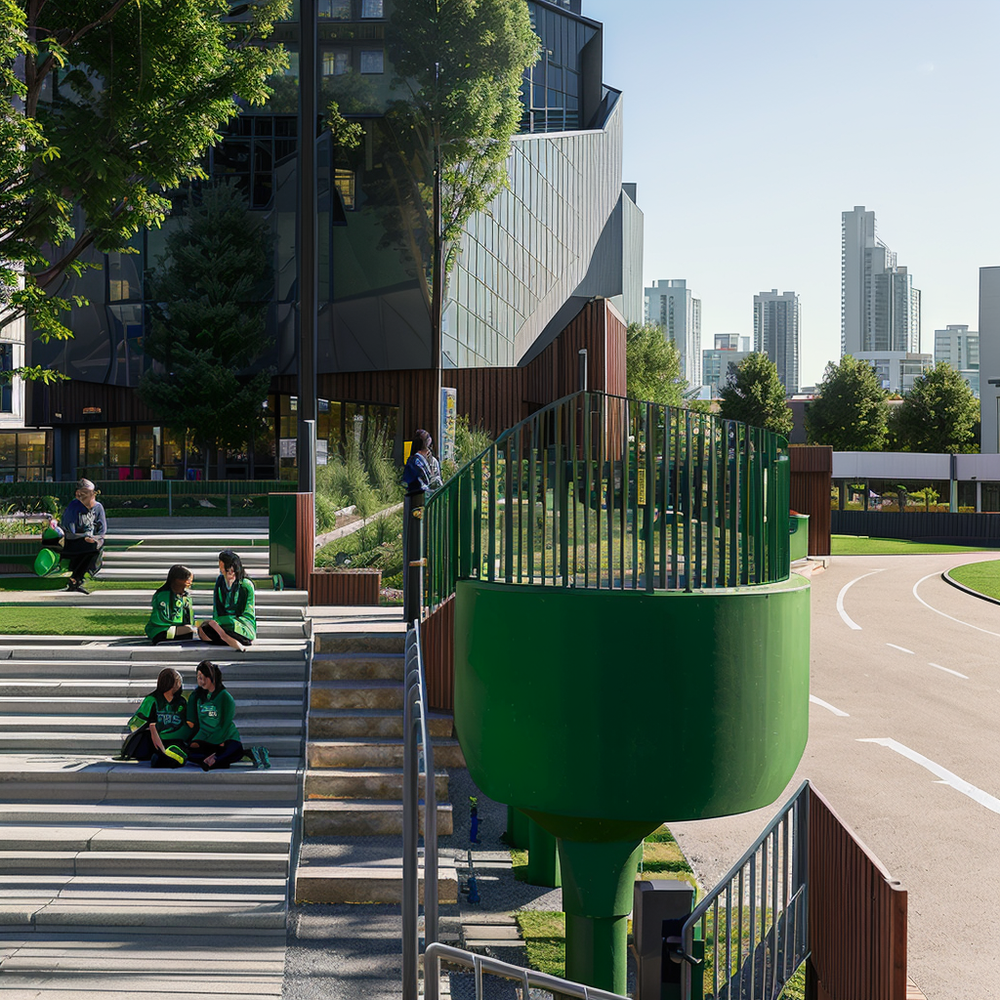

In [ ]:
prompt = ( "Engaging Community Interface, Shared Spaces, Interaction, School, Local Community, Facilities, Libraries, Auditoriums, Sports Complexes, Dual-Use, Academic Hours, Off-Hours, Symbiotic Environment, Educational Resources, Strengthen Community Ties, Collective Growth, Learning." "high-resolution, 8k, high-definition, ultra realistic, highly detailed, green space,21st century")
control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/10.jpg").resize((512, 512))

control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.6,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

Optimized Infrastructure, Accessibility, Efficient, Accessible, Smart Underground Parking, Maximize Space, Reduce Congestion, Campus Design, Pathways, Ramps, Elevations, ADA Compliance, Ease of Movement, Disability Inclusion.


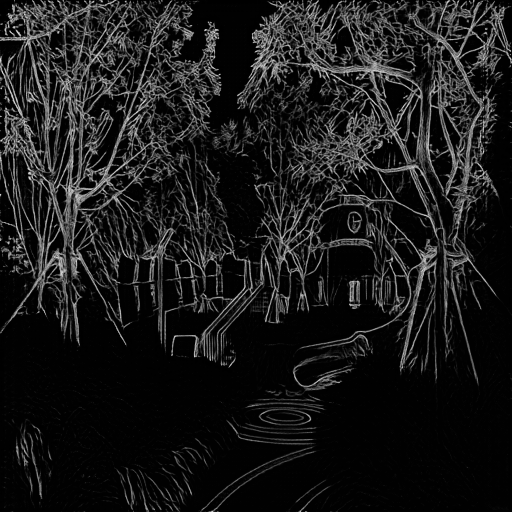

  0%|          | 0/40 [00:00<?, ?it/s]

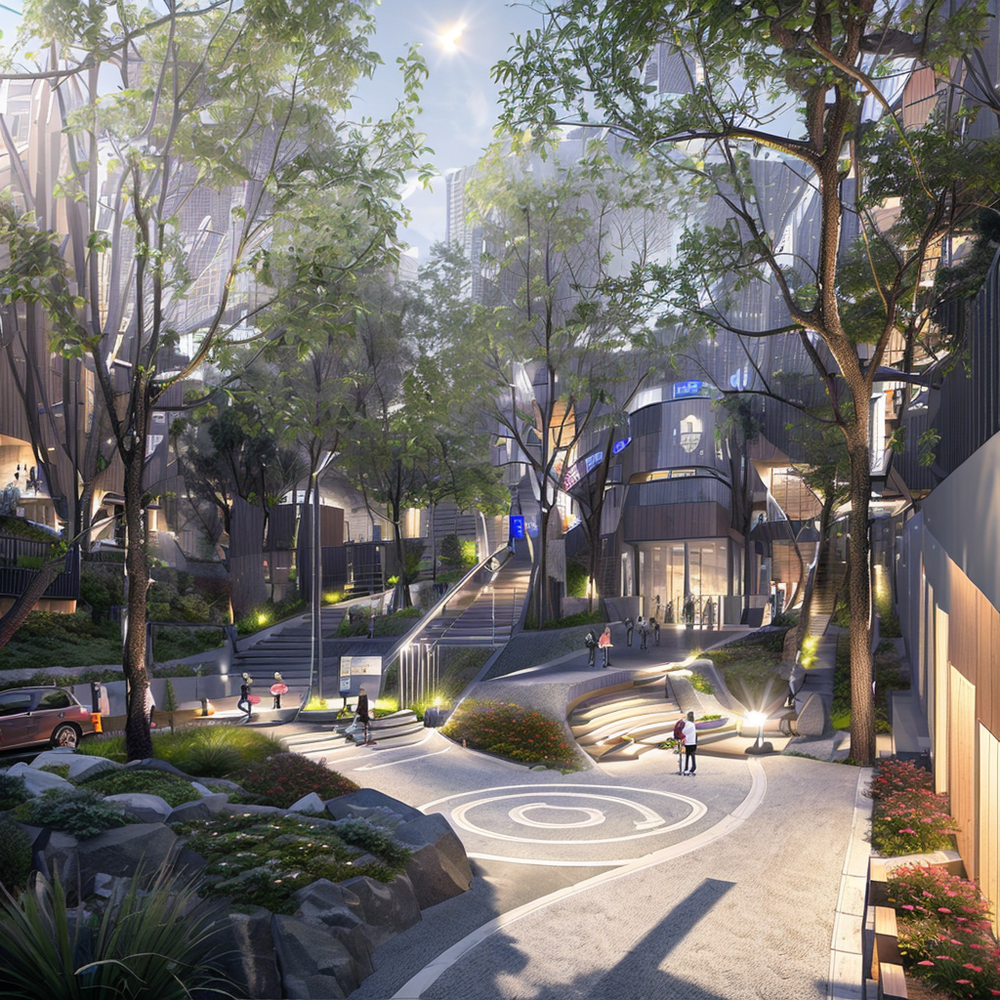

In [ ]:
prompt = ( "Optimized Infrastructure, Accessibility, Efficient, Accessible, Smart Underground Parking, Maximize Space, Reduce Congestion, Campus Design, Pathways, Ramps, Elevations, ADA Compliance, Ease of Movement, Disability Inclusion.")

control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/9.jpg").resize((512, 512))
control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.9,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

Optimized Infrastructure, Accessibility, Efficient, Accessible, Smart Underground Parking, Maximize Space, Reduce Congestion, Campus Design, Pathways, Ramps, Elevations, ADA Compliance, Ease of Movement, Disability Inclusion.


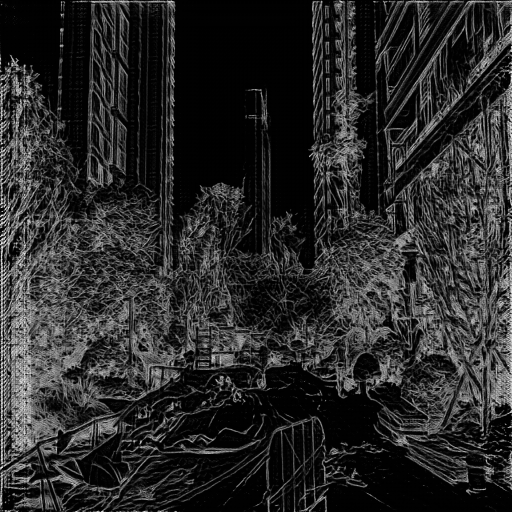

  0%|          | 0/40 [00:00<?, ?it/s]

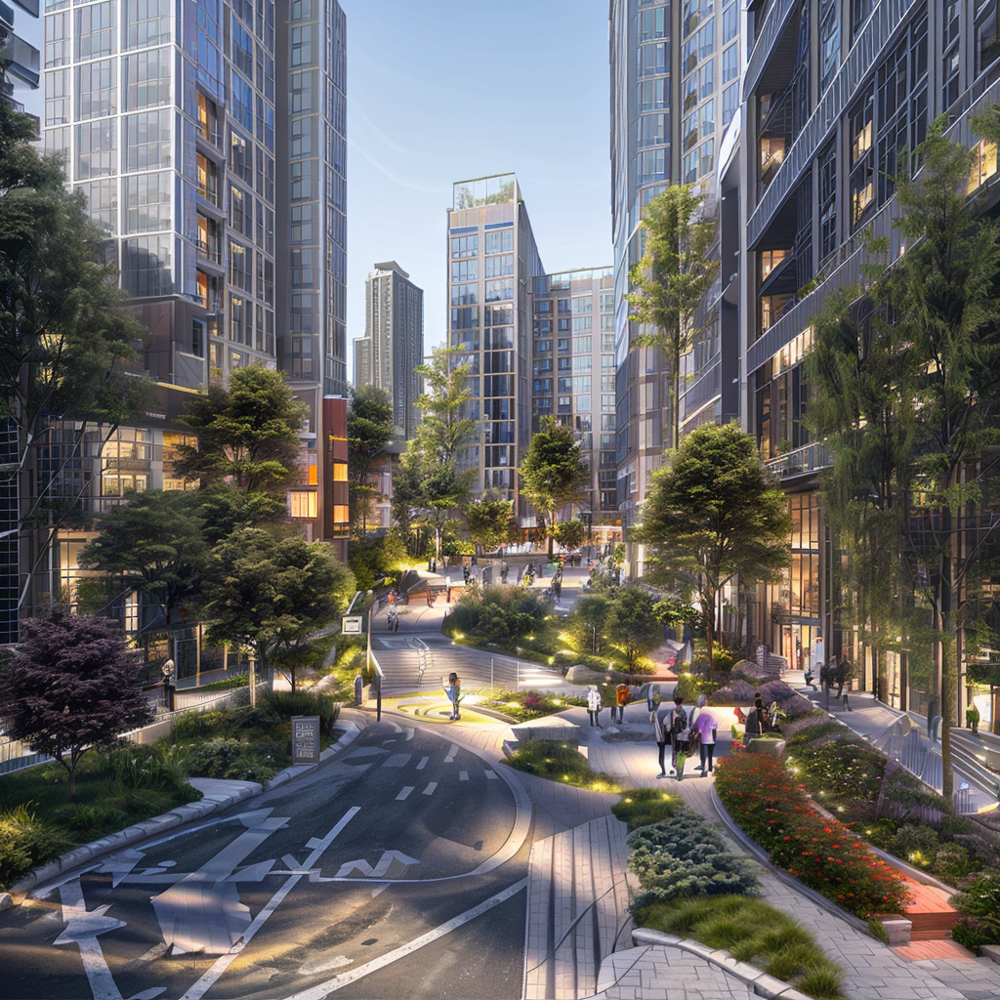

In [ ]:
prompt = ( "Optimized Infrastructure, Accessibility, Efficient, Accessible, Smart Underground Parking, Maximize Space, Reduce Congestion, Campus Design, Pathways, Ramps, Elevations, ADA Compliance, Ease of Movement, Disability Inclusion.")

control_image = Image.open("/content/drive/MyDrive/Agent/controlimage/11.jpg").resize((512, 512))
control_image = processor(control_image)
print(prompt)
display(control_image)

generator = torch.manual_seed(782241512)
image = pipe(prompt=prompt,
            #  image=image,
              negative_prompt=negative_prompt,
              guidance_scale=21,
              controlnet_conditioning_scale=0.5,
              generator=generator,
              image=control_image,
              height=1024, width=1024,
              num_inference_steps=40).images[0]
display(image)

# ============================视觉Agent完结============================